In [ ]:
# Uncomment these pip installs and run this cell for Colab
# !pip install setuptools==61.0.0 pyts mlflow plum-dispatch==1.7.2 torchdiffeq
# !pip install git+https://github.com/pnnl/neuromancer.git@master --ignore-requires-python --no-deps
    

# NeuroMANCER dynamical systems, system identification


!['image'](https://pnnl.github.io/neuromancer/_images/class_diagram.png)

In [1]:

from neuromancer.psl.signals import signals
import matplotlib.pyplot as plt
%matplotlib inline

# Input signals in neuromancer.psl

For a system identification task, a sequences of input signals must be generated in order to perturb the system across the dyanmic range of the state space. Neuromancer.psl has functions to generate all the standard perturbations used in system identification including:

+ Random walk: walk
+ White noise: noise
+ Random step functions: step
+ Randomly offset periodic functions (sin, cos, square, sawtooth): periodic
+ Sum of sines: sines
+ Auto-regressive moving average: arma
+ Cubic spline interpolation between randomly sampled points: splines

All input signal generator functions have the arguments: 

+ nsim: Length of input signal time series
+ d: Dimension of input signal time series
+ min: Minimum value for input signal time series
+ max: Maximum value for input signal time series

All signals are by default scaled to between min and max, however the unbounded signals white noise, random walk, and ARMA
have a bounded argument which can be set to false if an unbounded signal is desired. 

Below are plots of each signal time series generated with nsim=1000 and d=3.

In [2]:
signals

{'sin': functools.partial(<function periodic at 0x7f79ff832680>, form='sin'),
 'square': functools.partial(<function periodic at 0x7f79ff832680>, form='square'),
 'sawtooth': functools.partial(<function periodic at 0x7f79ff832680>, form='sawtooth'),
 'walk': <function neuromancer.psl.signals.walk(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True)>,
 'noise': <function neuromancer.psl.signals.noise(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True)>,
 'step': <function neuromancer.psl.signals.step(nsim, d, min=0.0, max=1.0, randsteps=30, values=None)>,
 'spline': <function neuromancer.psl.signals.spline(nsim, d, min=0.0, max=1.0, values=None, n_interpolants=30)>,
 'sines': <function neuromancer.psl.signals.sines(nsim, d, min=0.0, max=1.0, periods=30, nwaves=20, form='sin')>,
 'arma': <function neuromancer.psl.signals.arma(nsim, d, min=0.0, max=1.0, q=10, p=10, bound=True)>,
 'prbs': <function neuromancer.psl.signals.prbs(nsim, d, min=0.0, max=1.0, p=0.9)>}

sin (1000, 3)


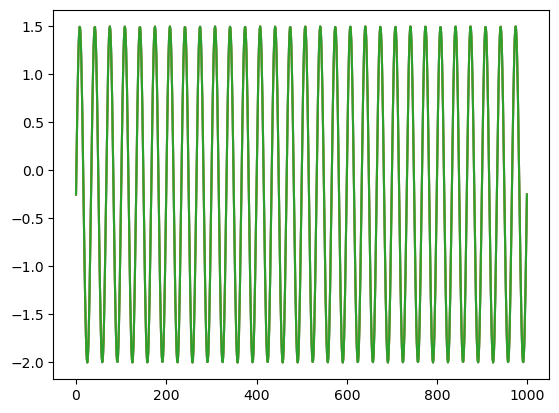

square (1000, 3)


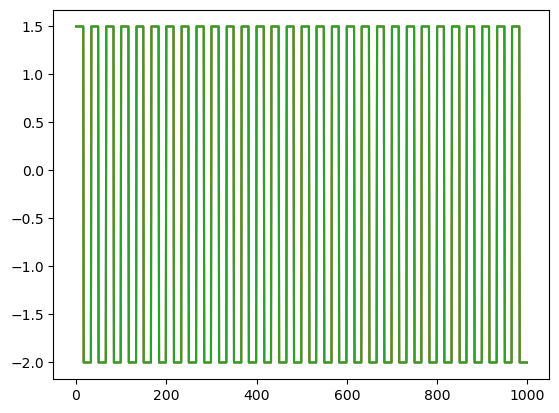

sawtooth (1000, 3)


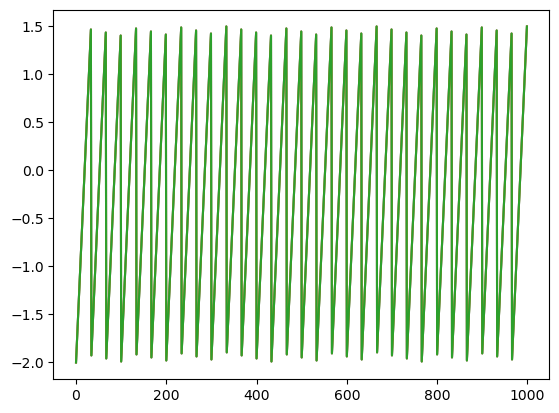

walk (1000, 3)


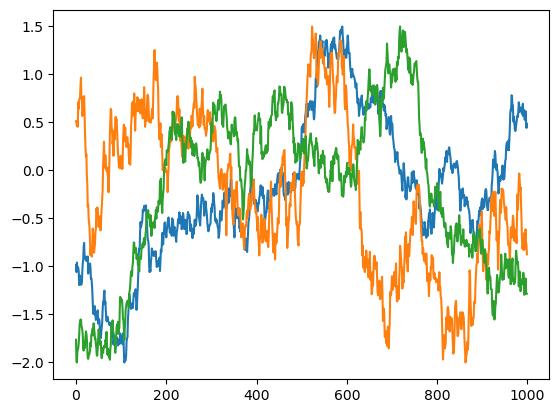

noise (1000, 3)


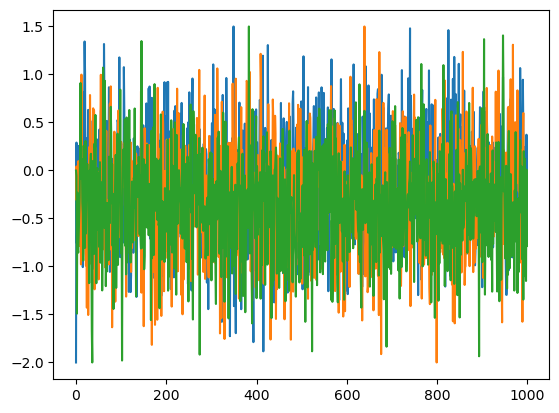

step (1000, 3)


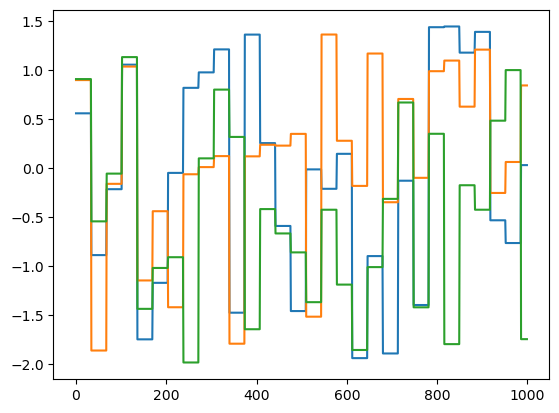

spline (1000, 3)


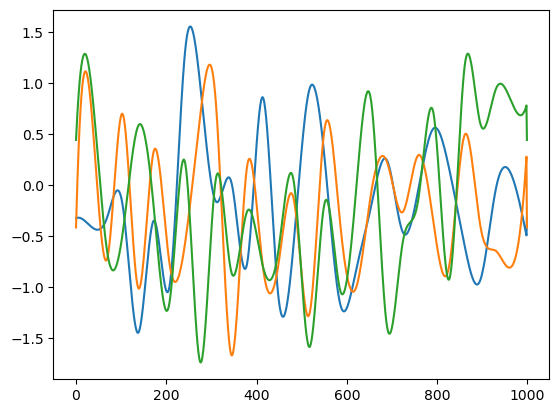

sines (1000, 3)


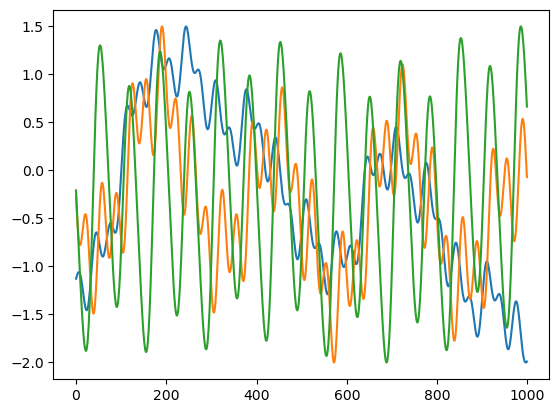

arma (1000, 3)


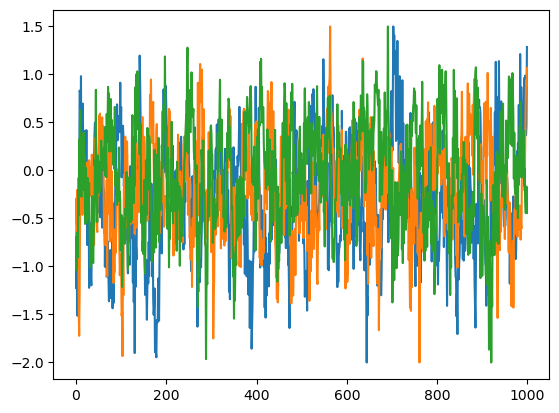

prbs (1000, 3)


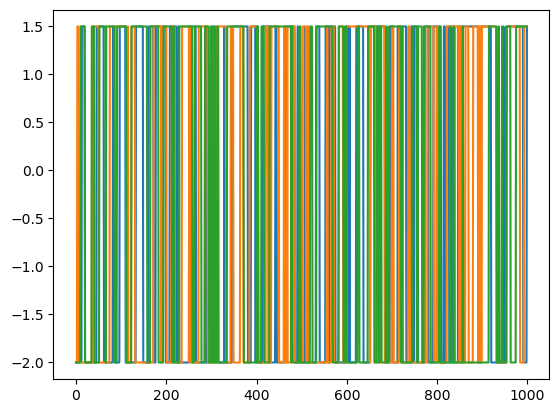

In [3]:
for n, s in signals.items():
    x = s(1000, 3, min=-2., max=1.5)
    print(n, x.shape)
    plt.plot(x)
    plt.show()
    plt.close()

# Systems in NM's Python Systems Library (psl)

The psl subpackage provides systems models for a range of autonomous, nonautonomous, networked, and building envelope systems, as well as an interface for loading and interacting with pre-recorded measurement datasets in common with the systems models. 

In [3]:
import neuromancer
neuromancer.psl.systems

{'Autoignition': neuromancer.psl.autonomous.Autoignition,
 'Brusselator1D': neuromancer.psl.autonomous.Brusselator1D,
 'ChuaCircuit': neuromancer.psl.autonomous.ChuaCircuit,
 'DoublePendulum': neuromancer.psl.autonomous.DoublePendulum,
 'Duffing': neuromancer.psl.autonomous.Duffing,
 'LorenzSystem': neuromancer.psl.autonomous.LorenzSystem,
 'LotkaVolterra': neuromancer.psl.autonomous.LotkaVolterra,
 'Pendulum': neuromancer.psl.autonomous.Pendulum,
 'RosslerAttractor': neuromancer.psl.autonomous.RosslerAttractor,
 'ThomasAttractor': neuromancer.psl.autonomous.ThomasAttractor,
 'UniversalOscillator': neuromancer.psl.autonomous.UniversalOscillator,
 'VanDerPol': neuromancer.psl.autonomous.VanDerPol,
 'Actuator': neuromancer.psl.nonautonomous.Actuator,
 'CSTR': neuromancer.psl.nonautonomous.CSTR,
 'DuffingControl': neuromancer.psl.nonautonomous.DuffingControl,
 'HindmarshRose': neuromancer.psl.nonautonomous.HindmarshRose,
 'InvPendulum': neuromancer.psl.nonautonomous.InvPendulum,
 'IverSim

Autoignition


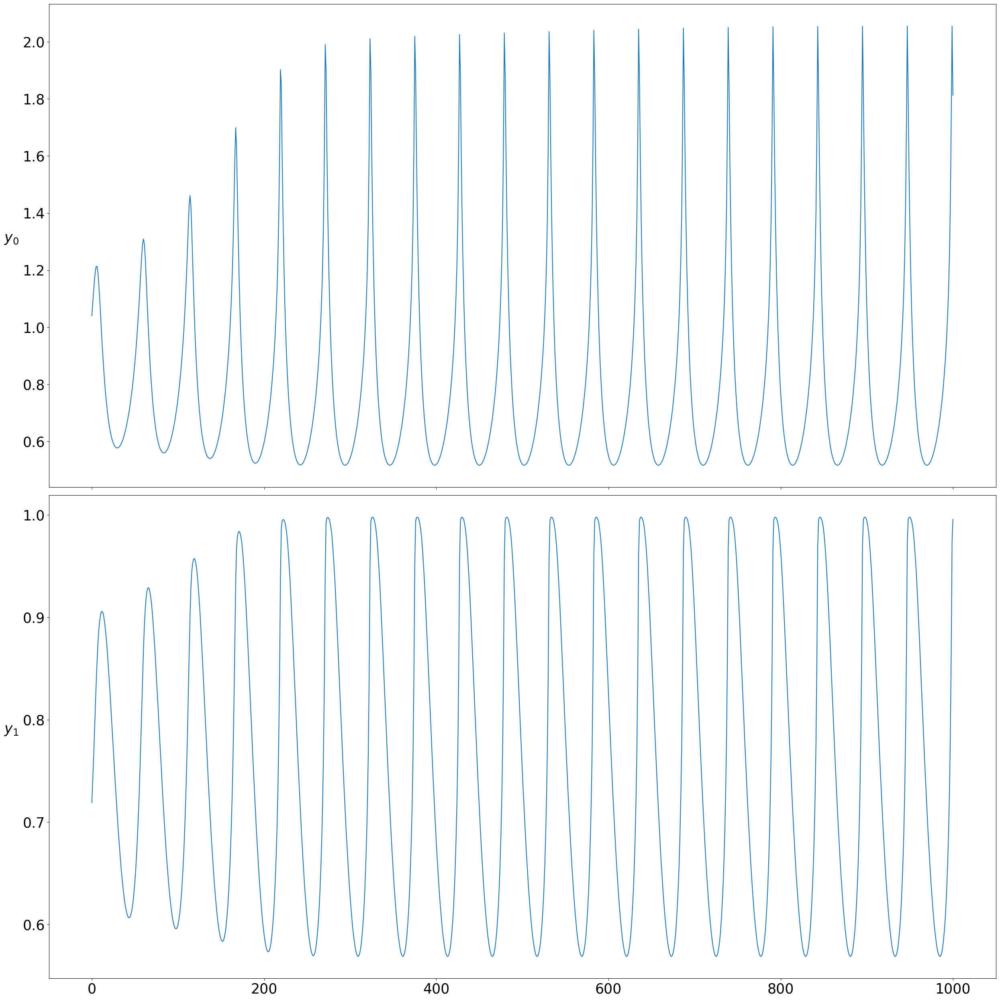

Brusselator1D


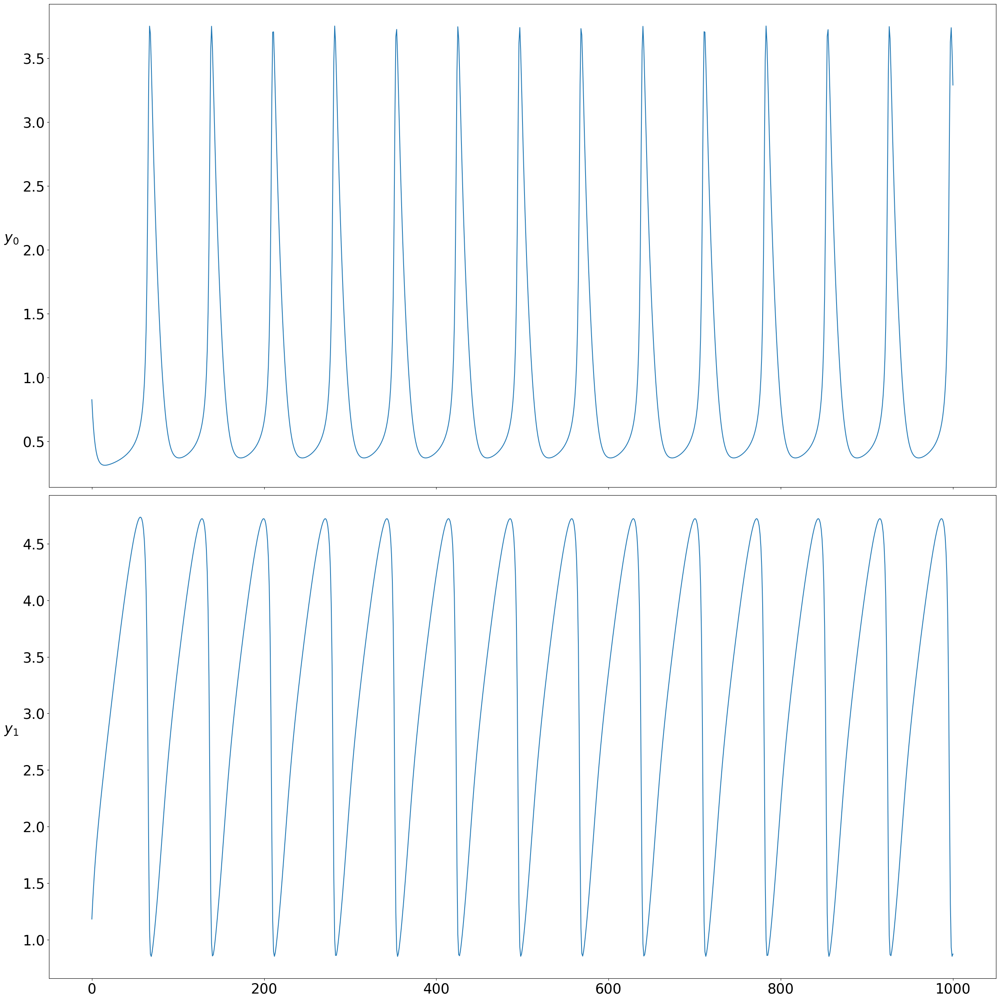

ChuaCircuit


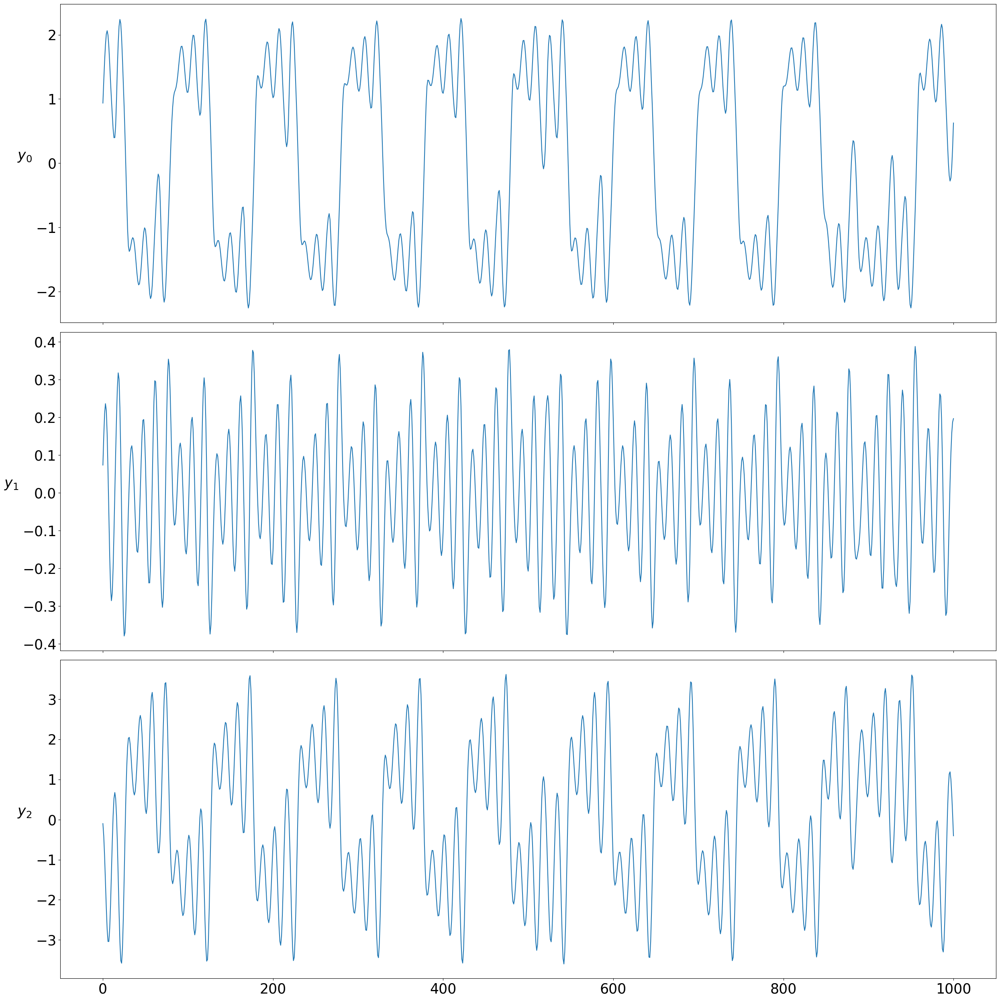

DoublePendulum


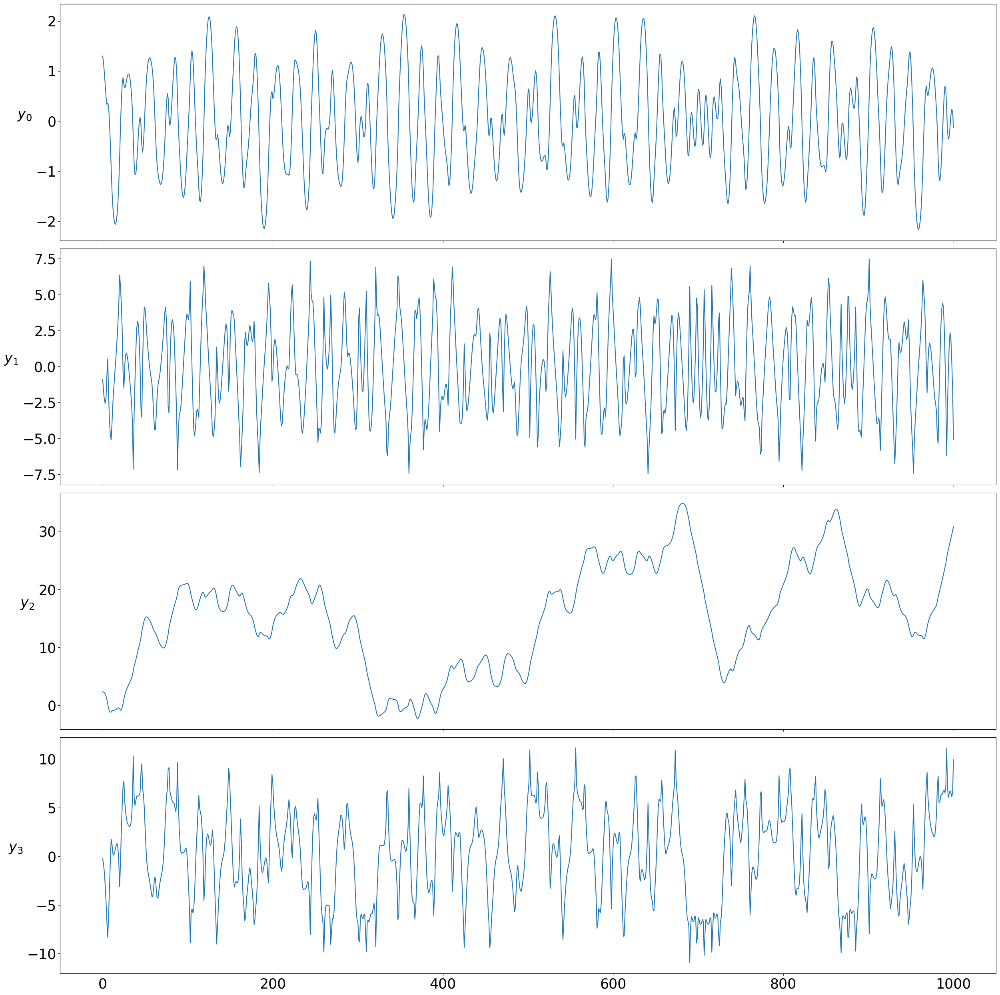

Duffing


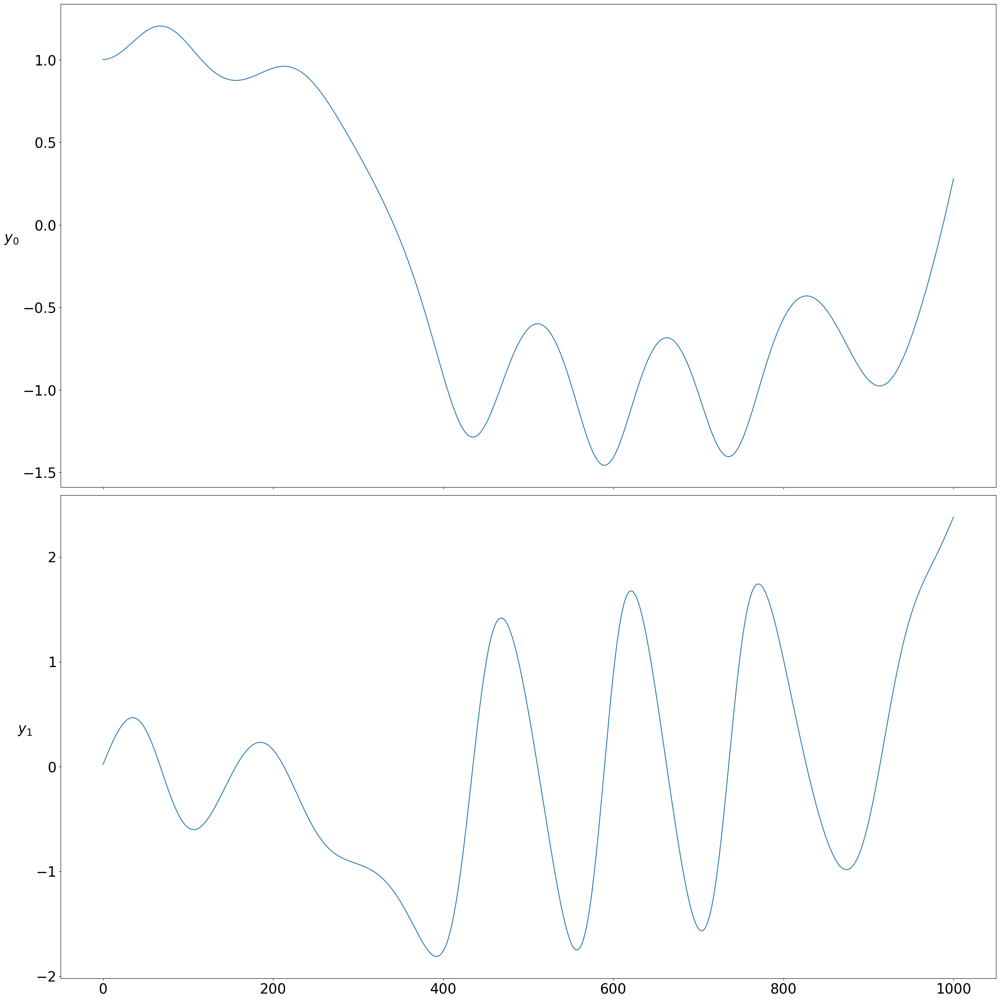

LorenzSystem


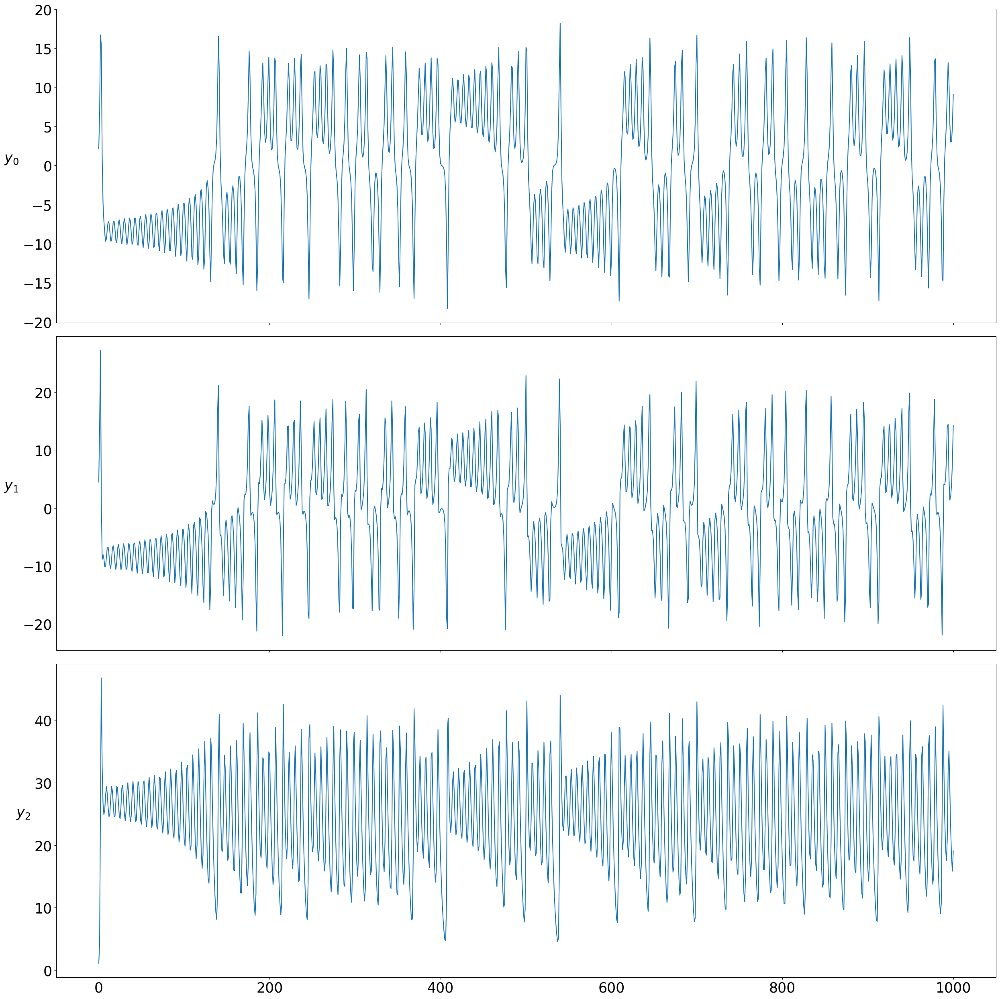

LotkaVolterra


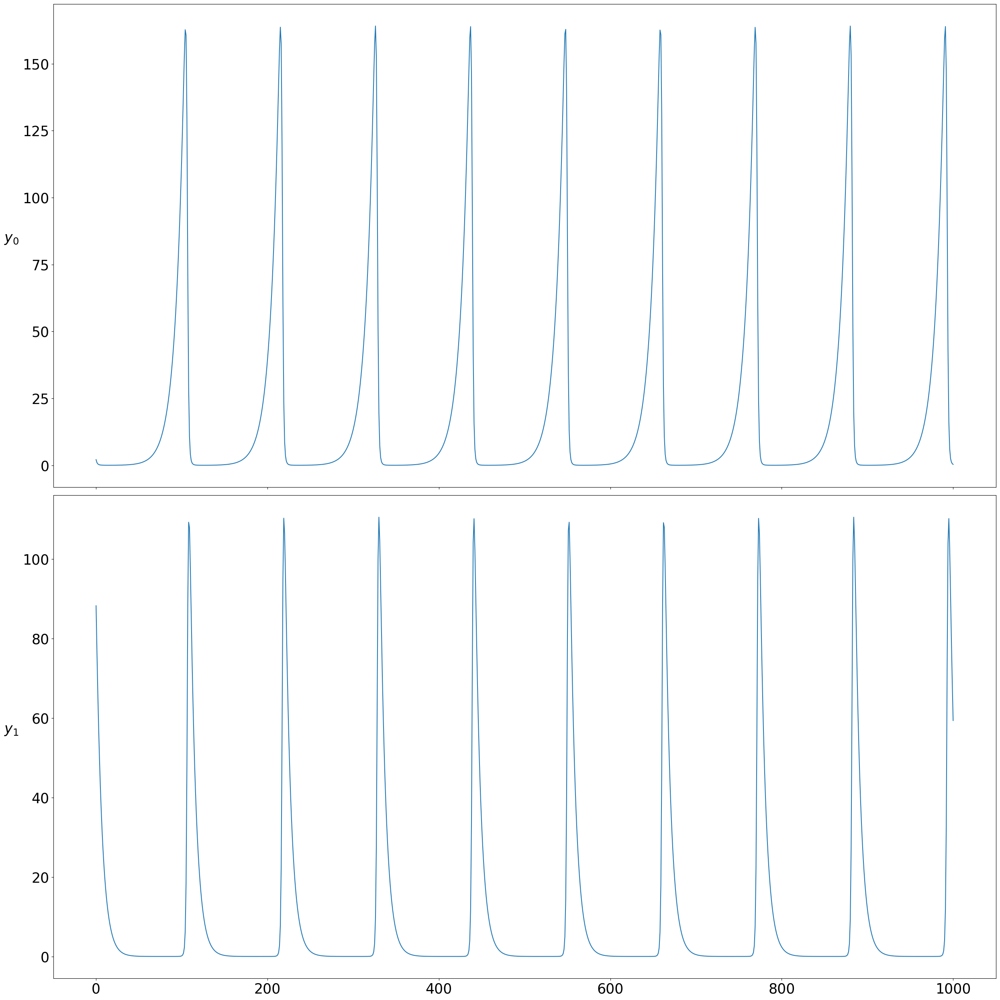

Pendulum


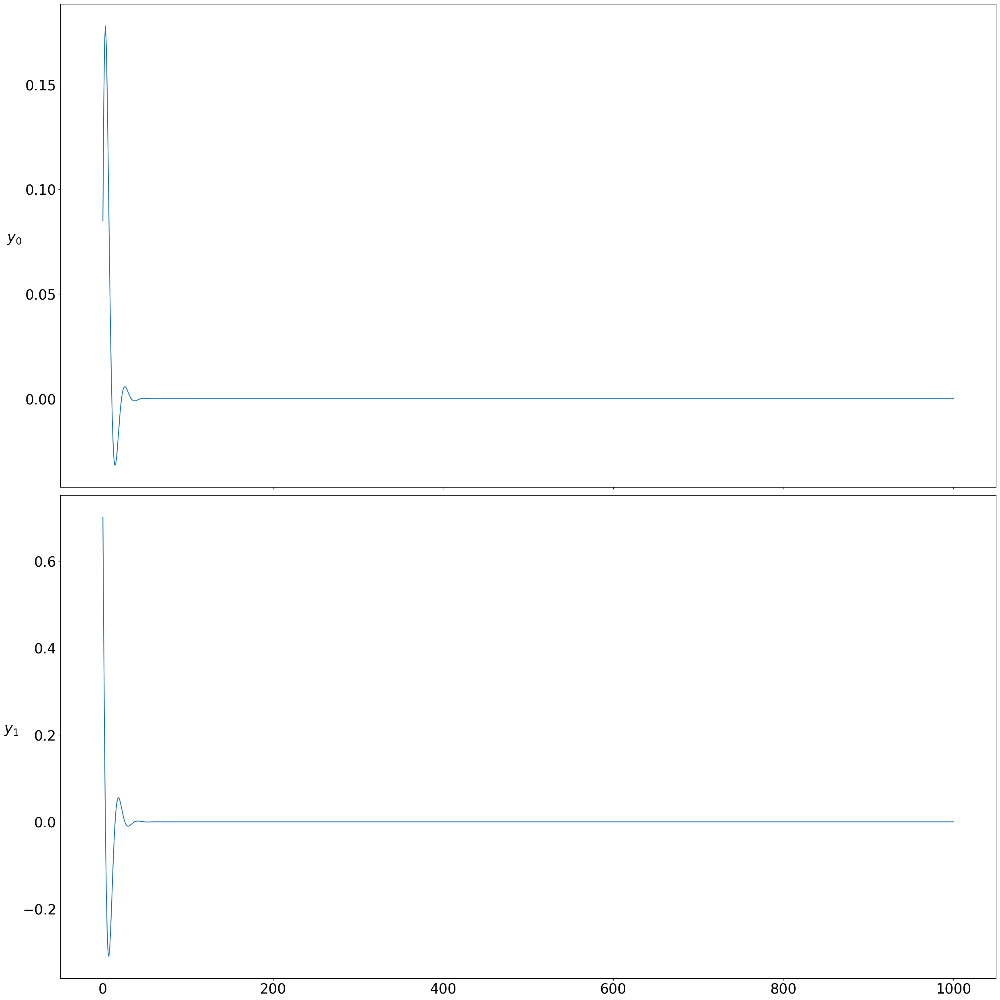

RosslerAttractor


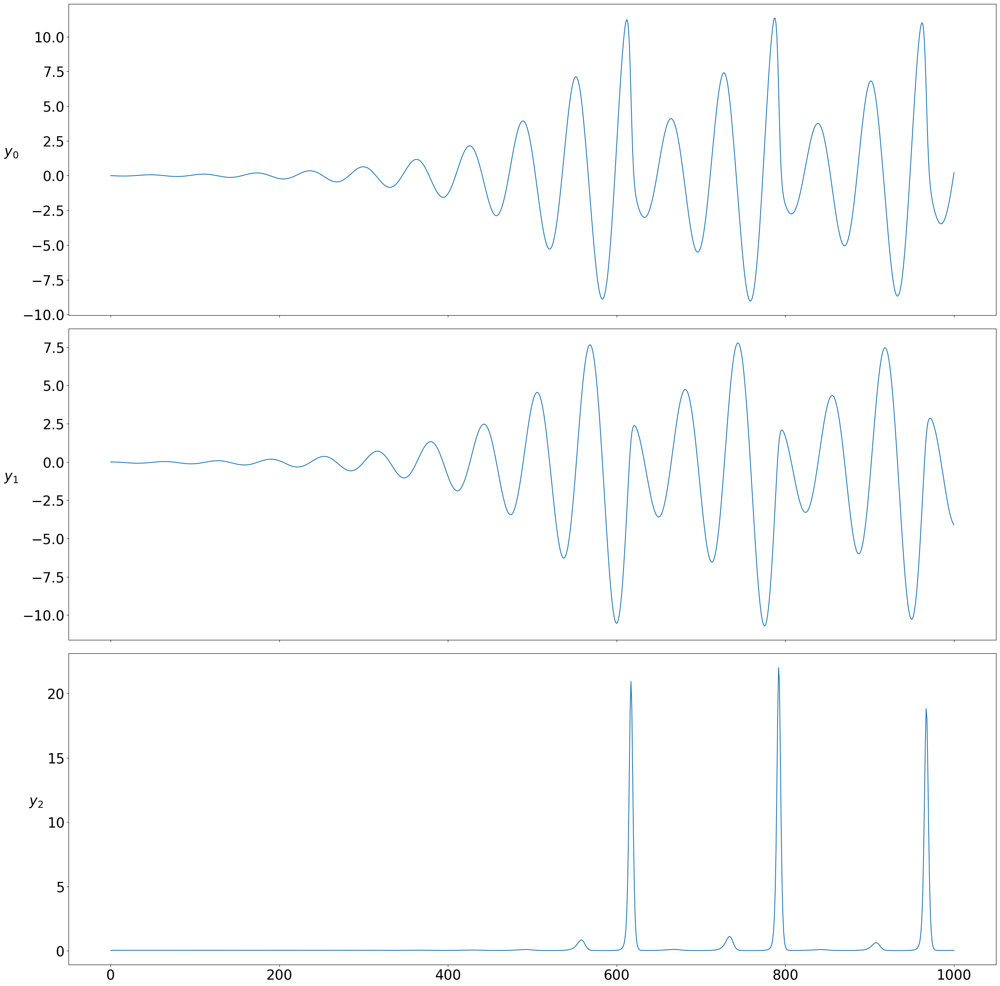

ThomasAttractor


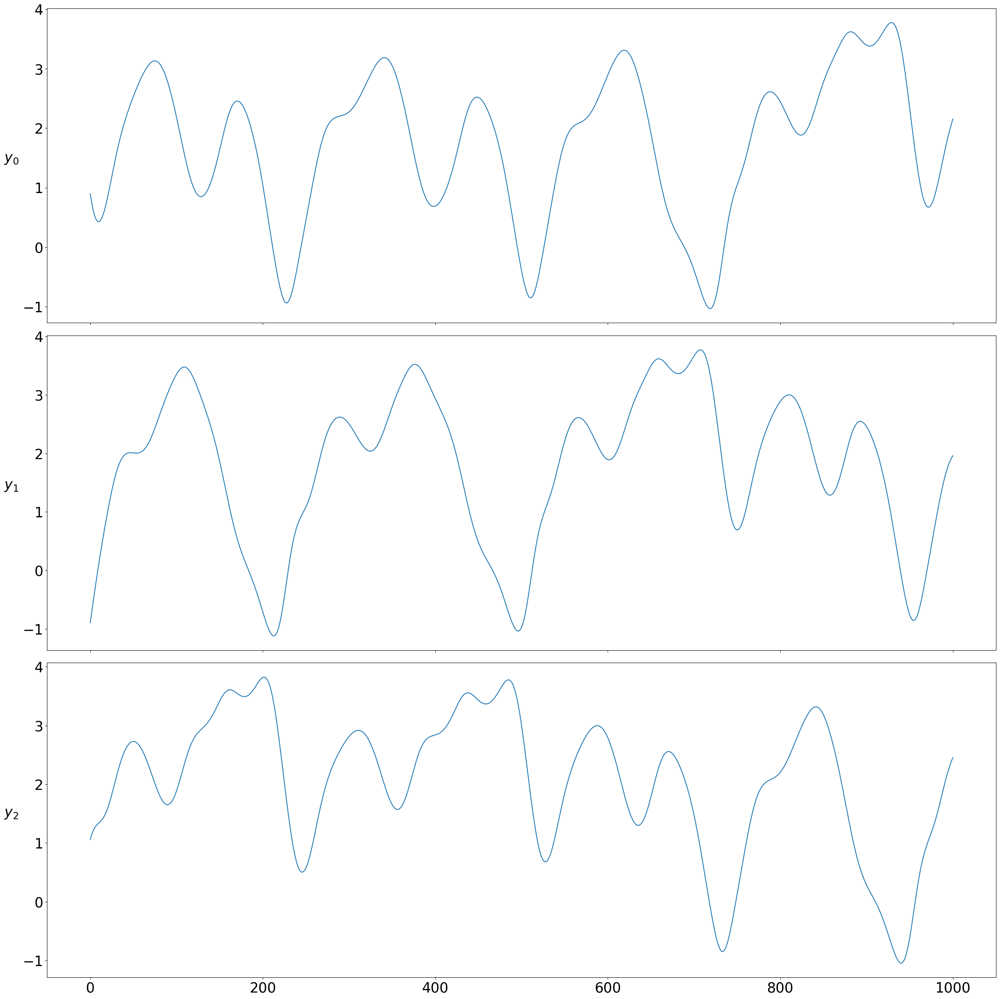

UniversalOscillator


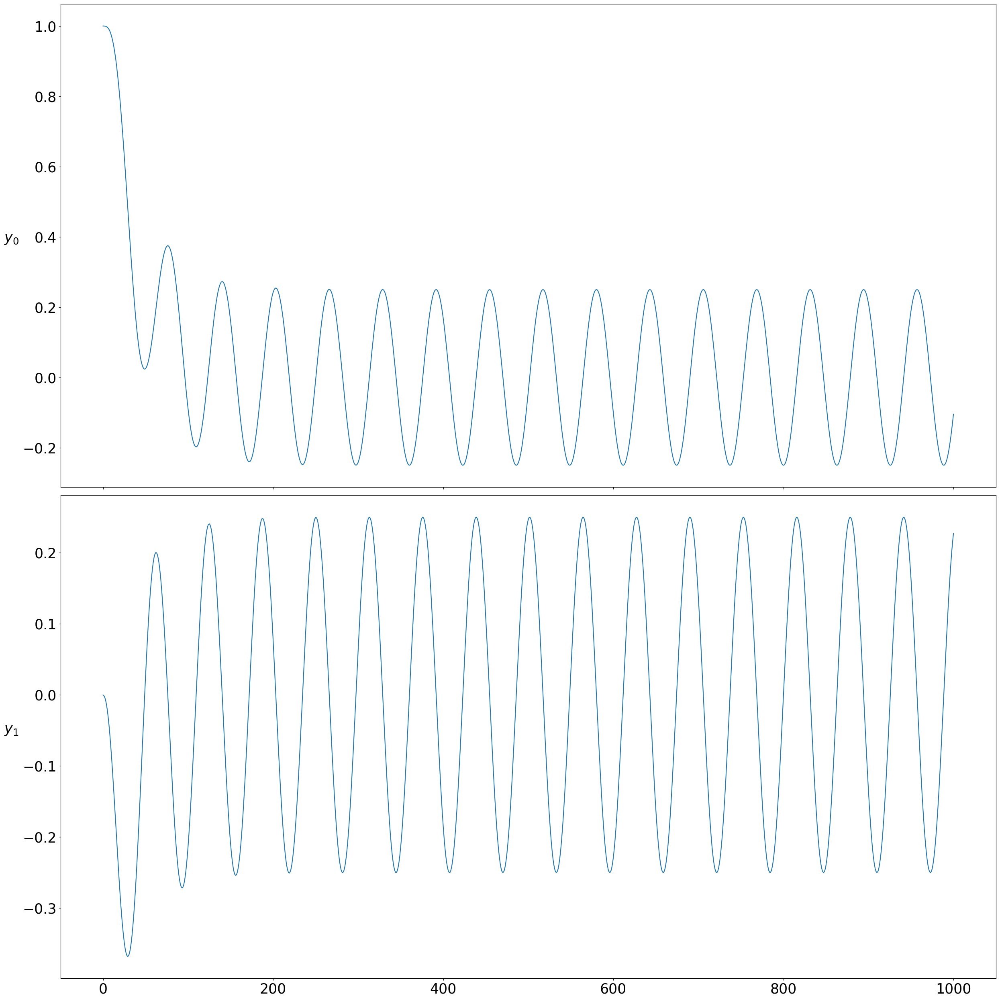

VanDerPol


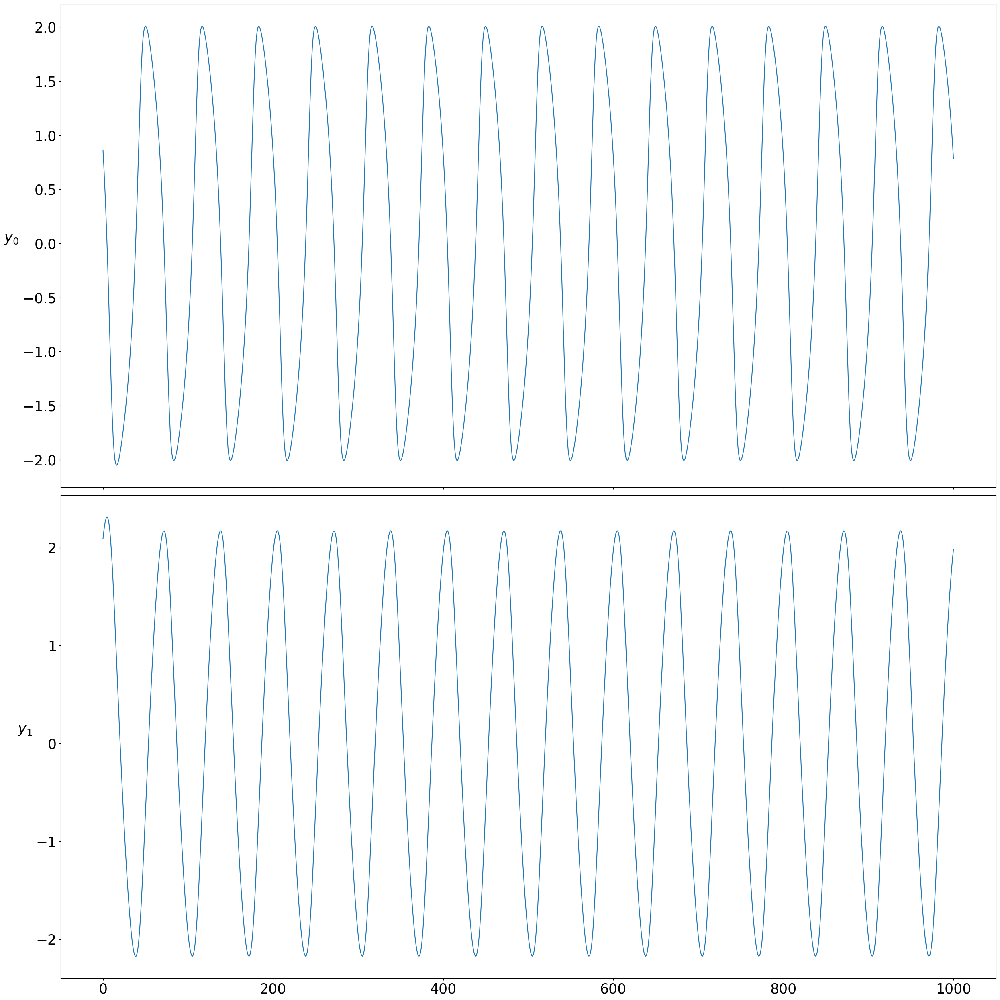

Actuator


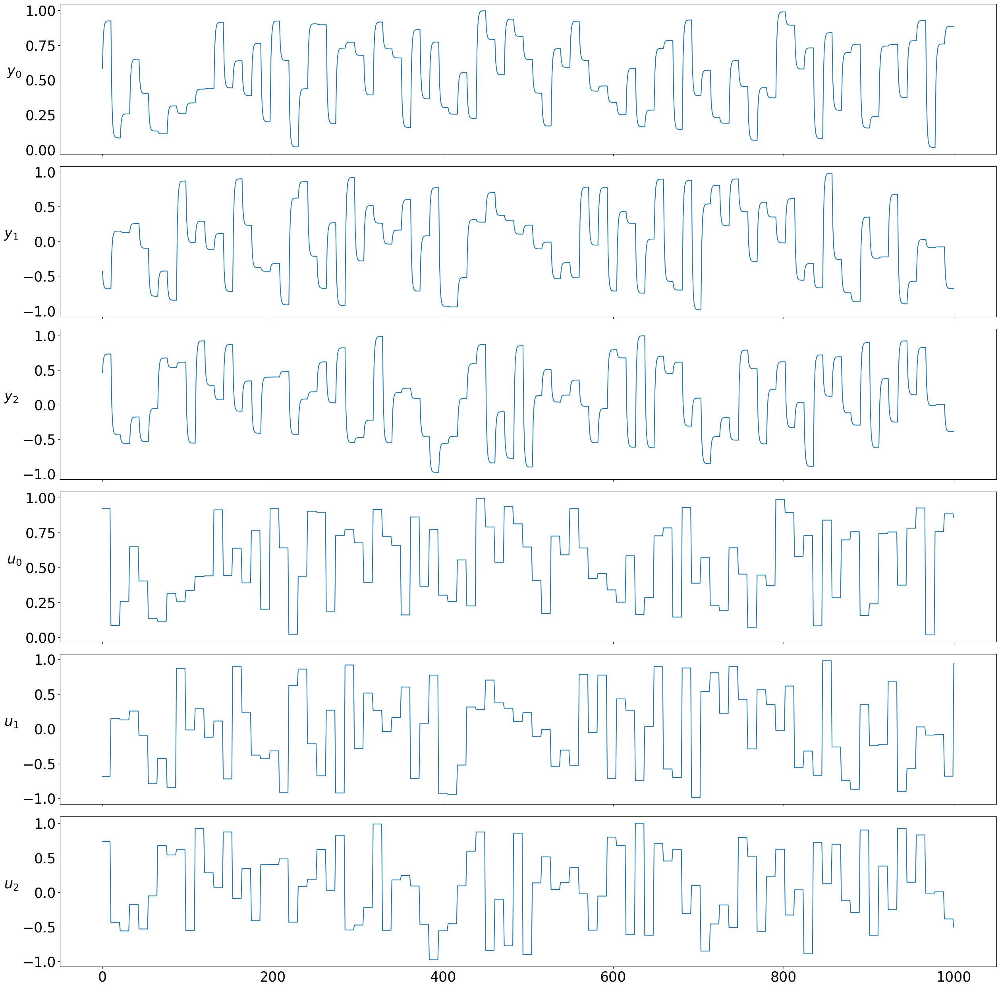

CSTR


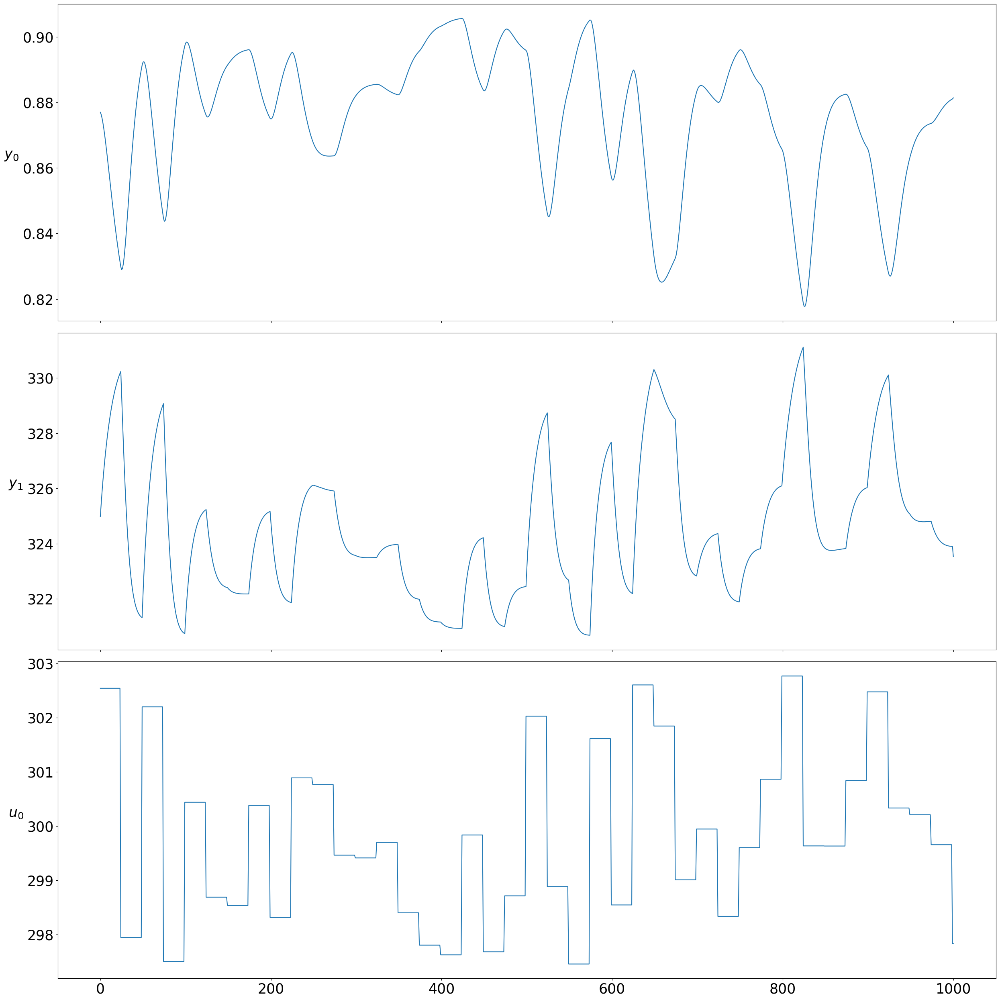

DuffingControl


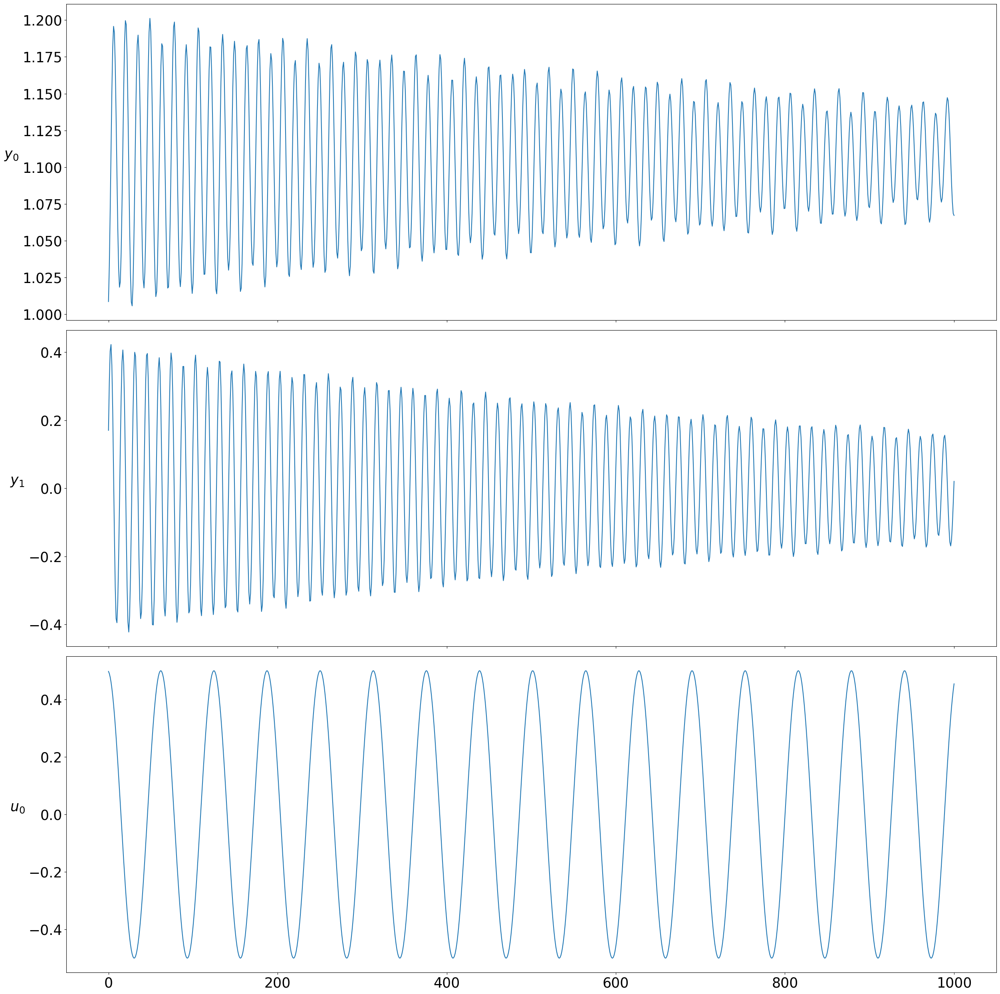

HindmarshRose


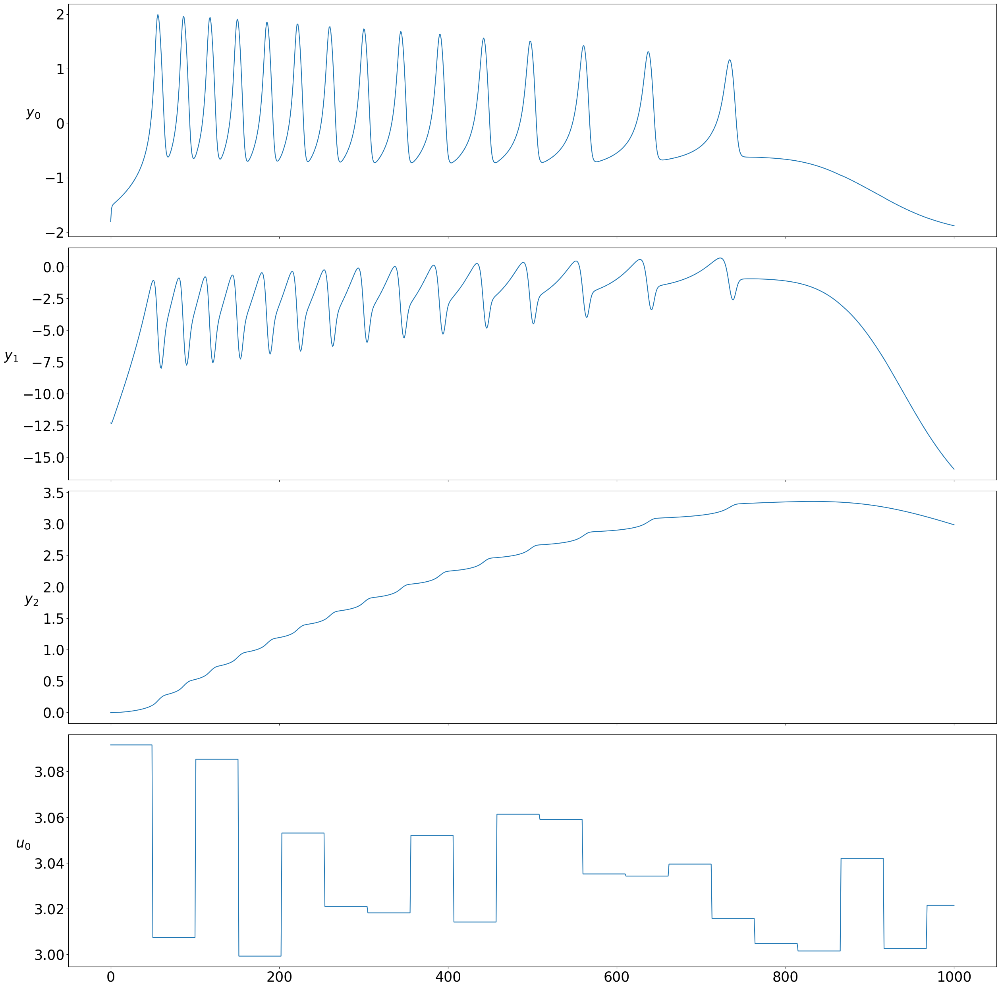

InvPendulum


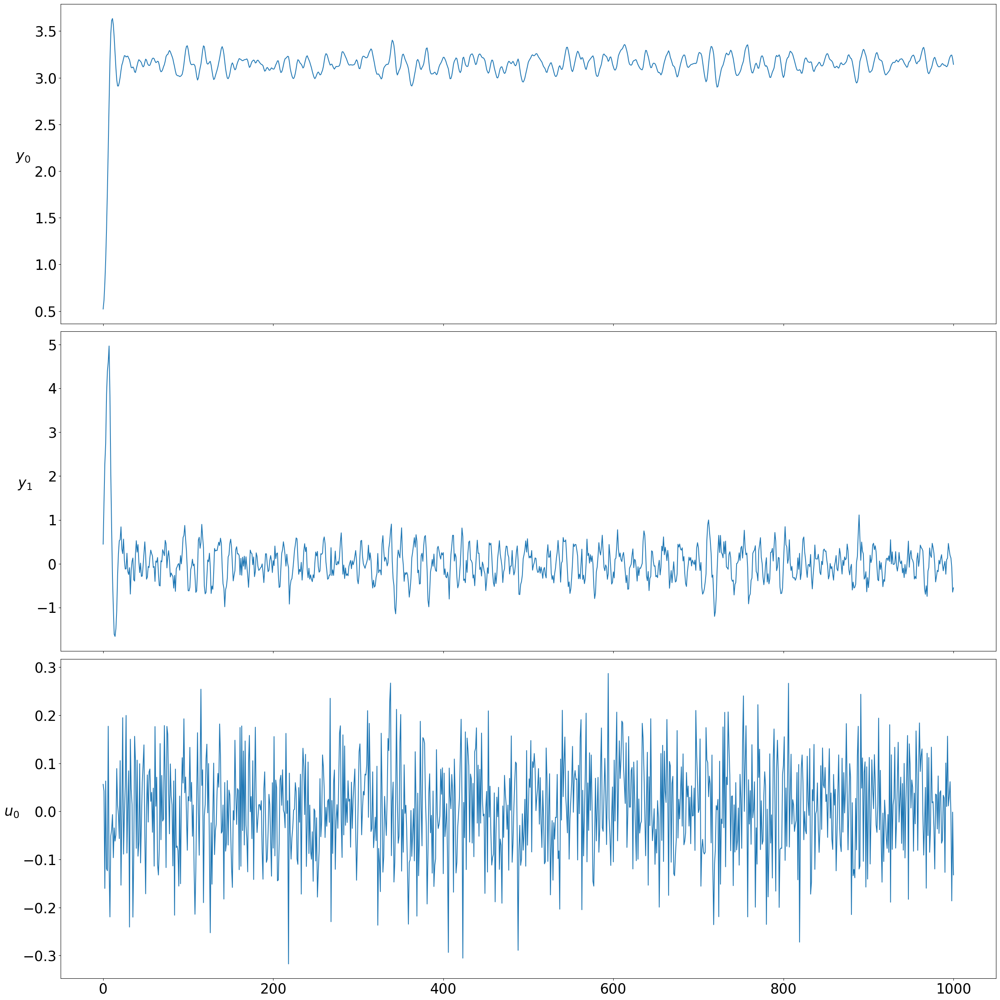

IverSimple


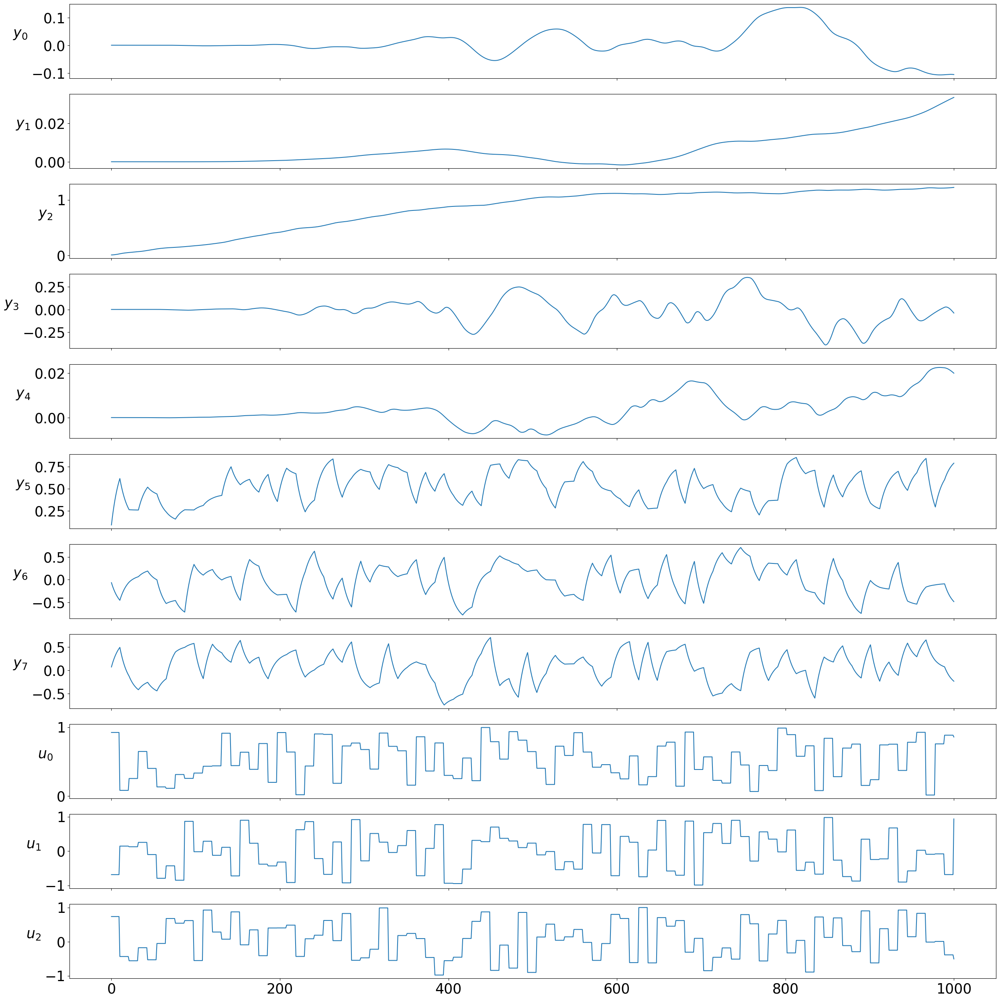

LorenzControl


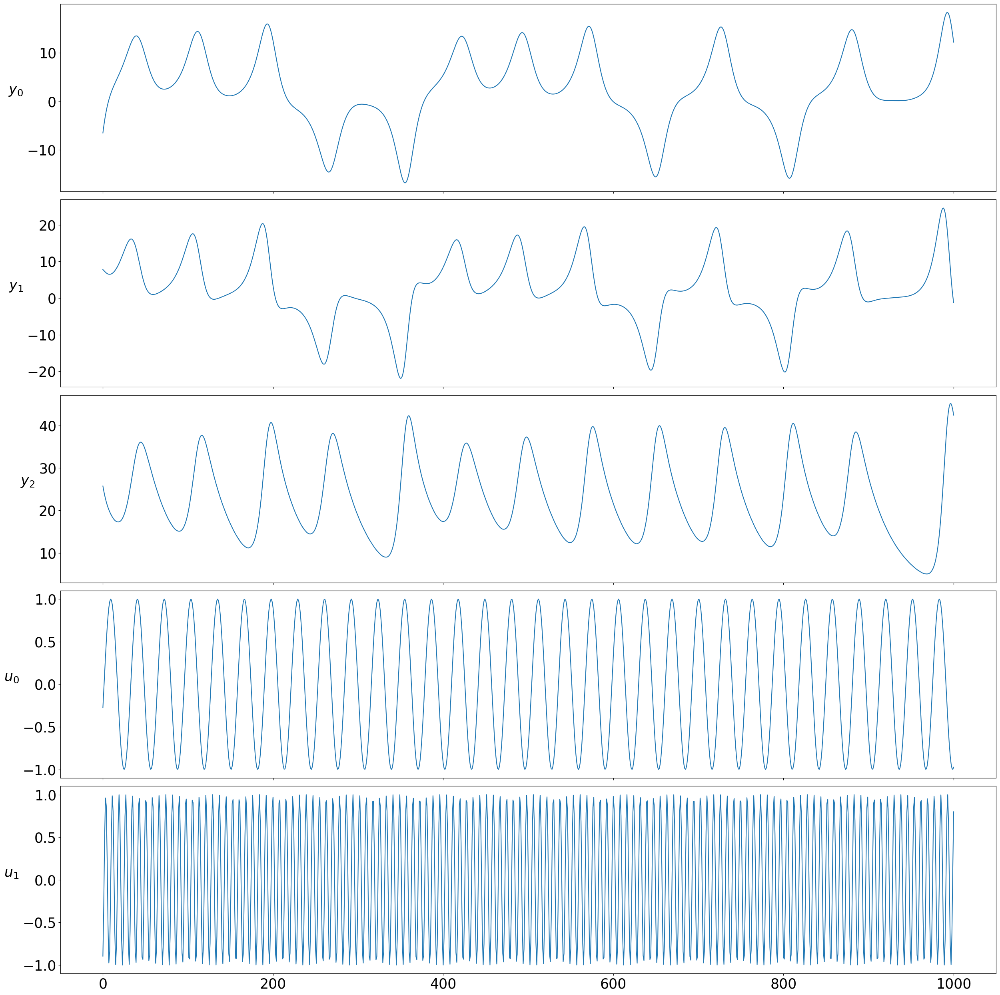

SEIR_population


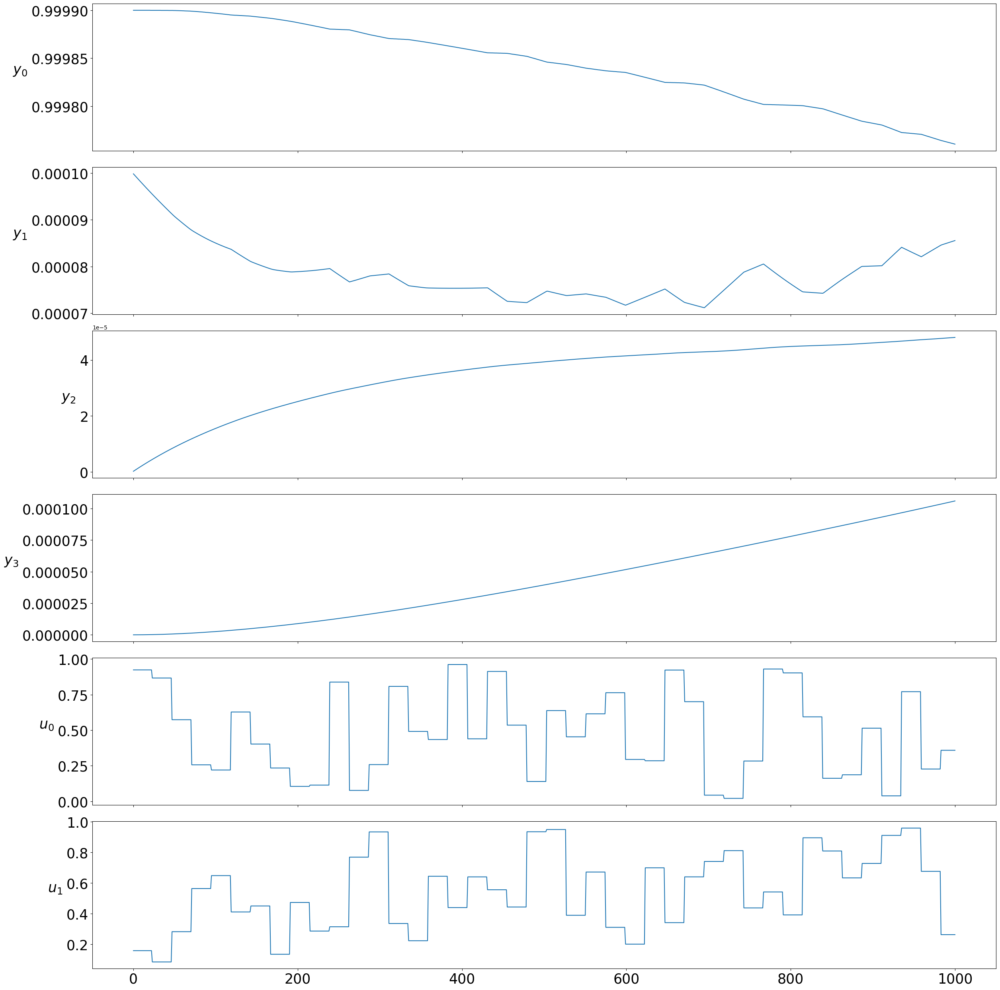

SwingEquation


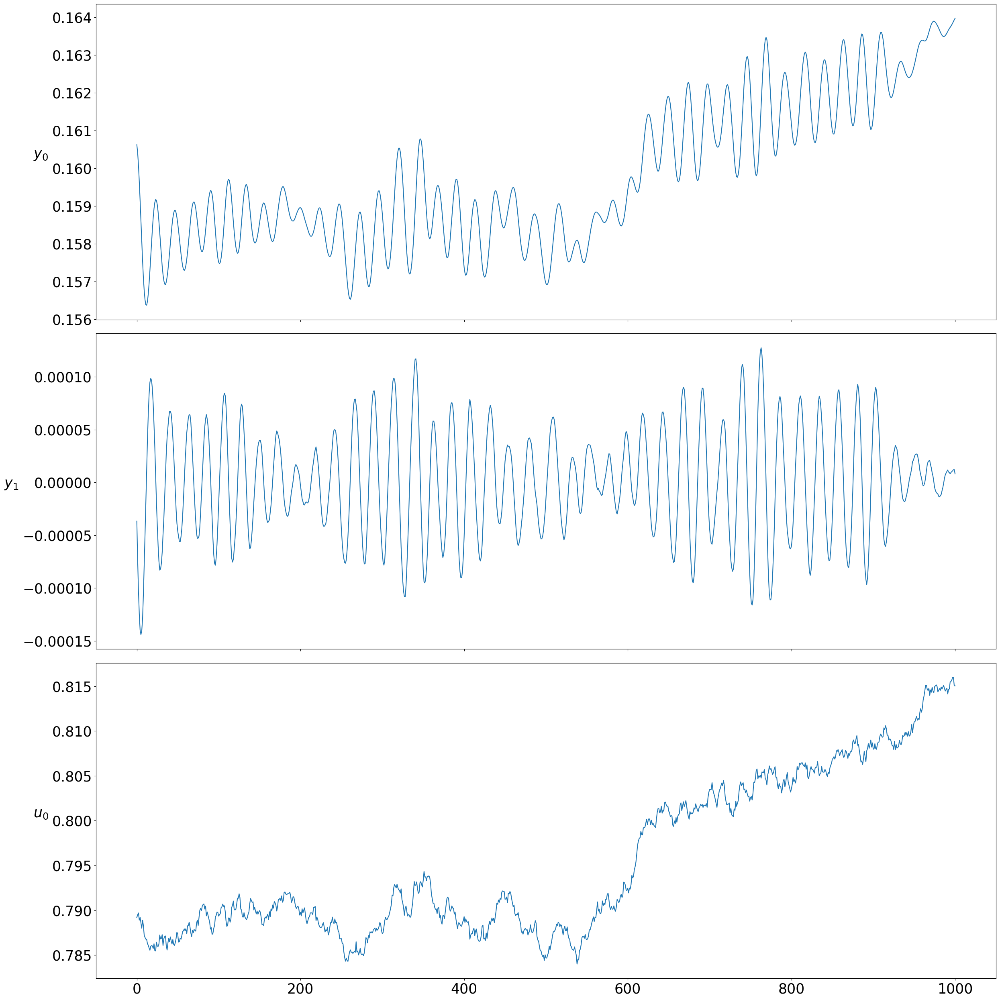

Tank


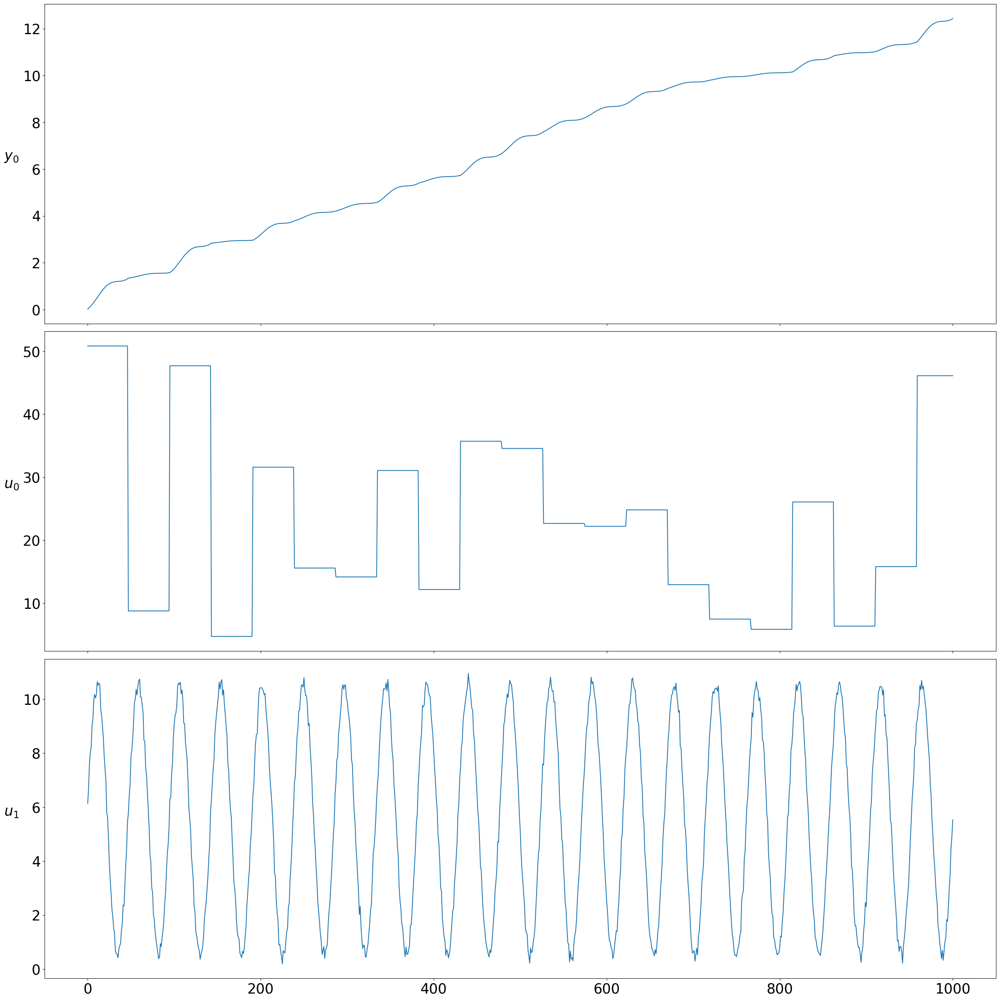

ThomasAttractorControl


/mnt/c/Users/tuor369/gitland/neuromancer_main/neuromancer/src/neuromancer/psl/base.py:274: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


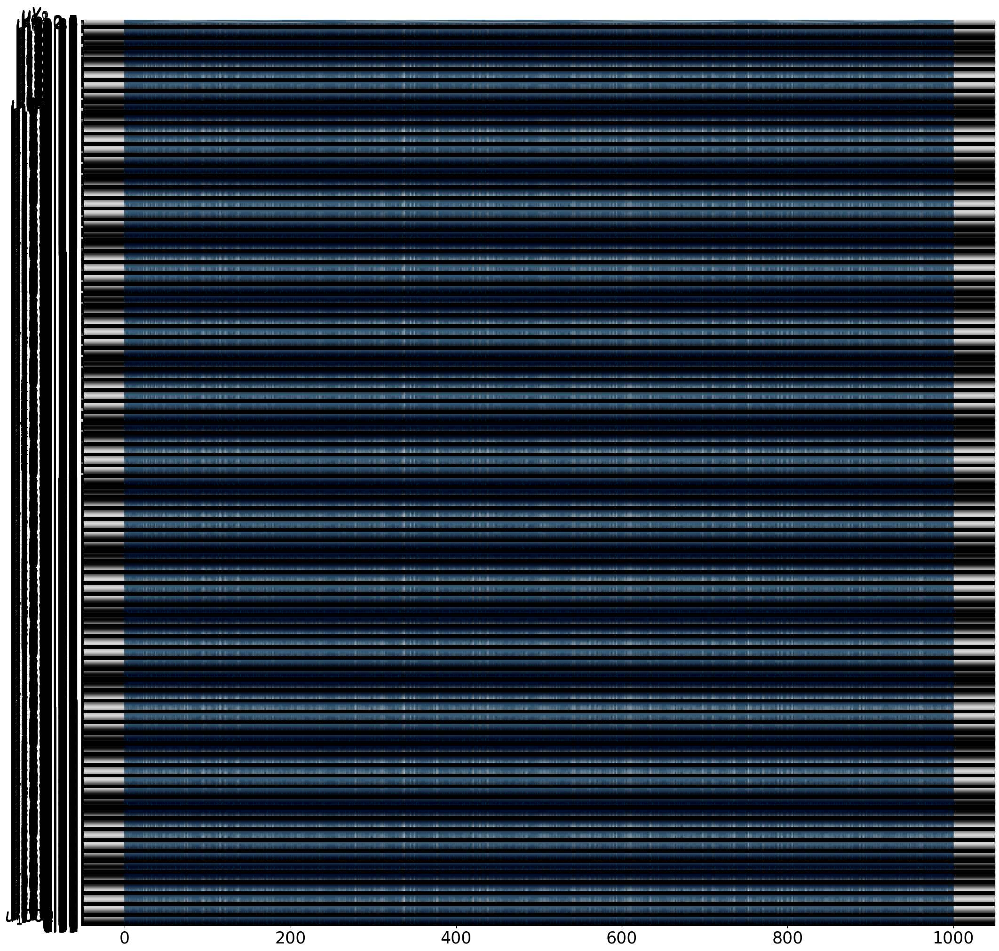

TwoTank


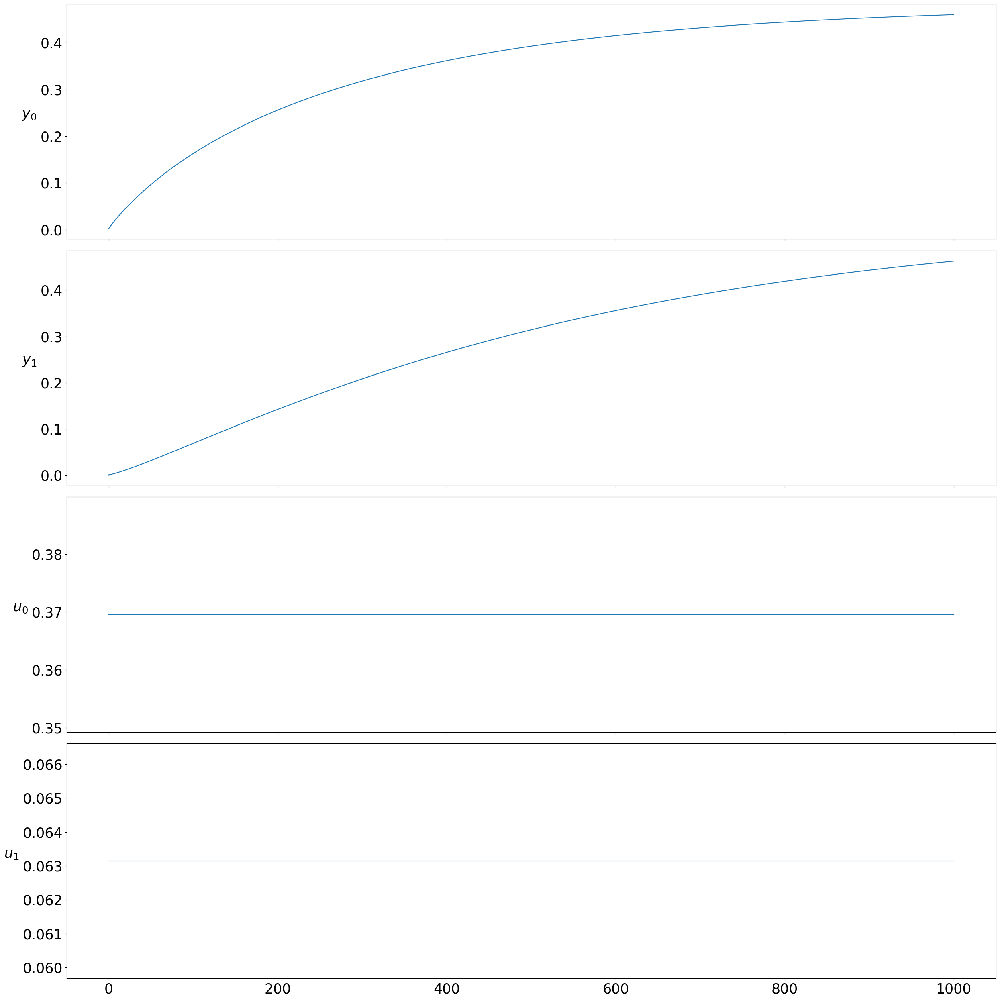

VanDerPolControl


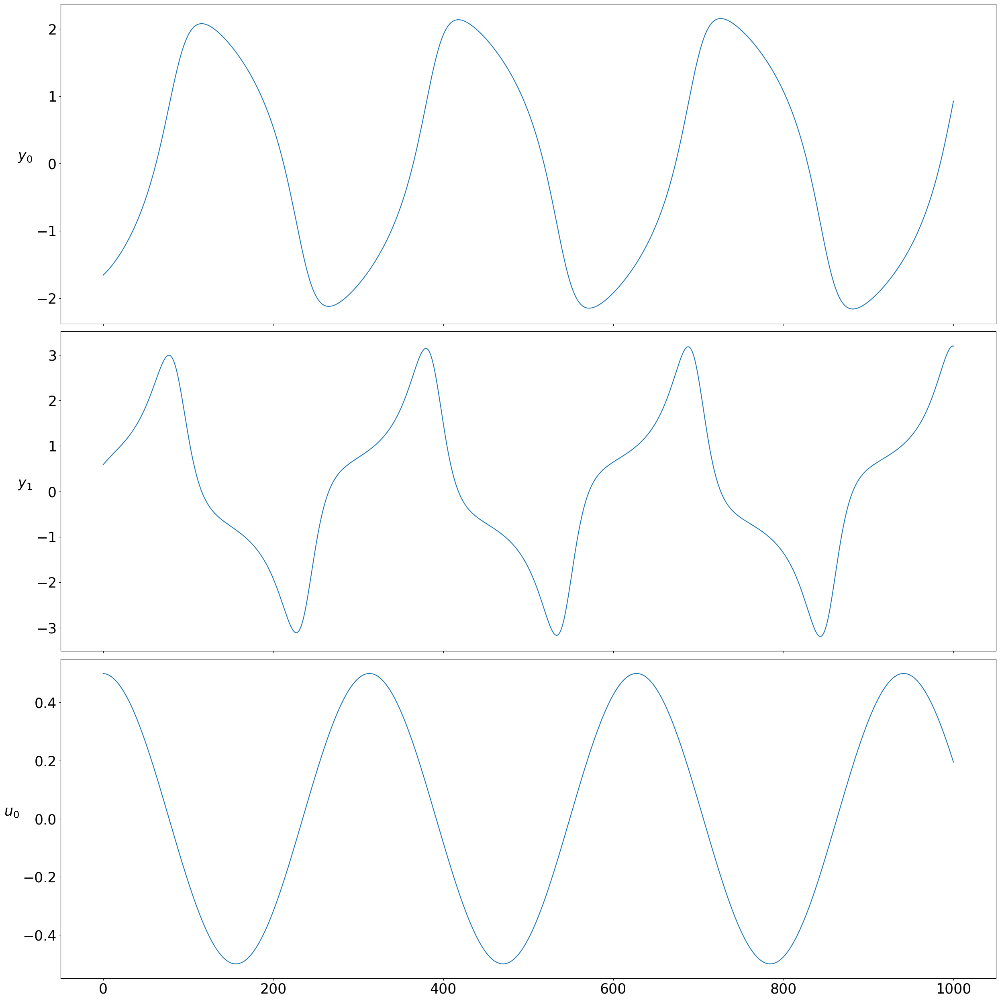

SimpleSingleZone


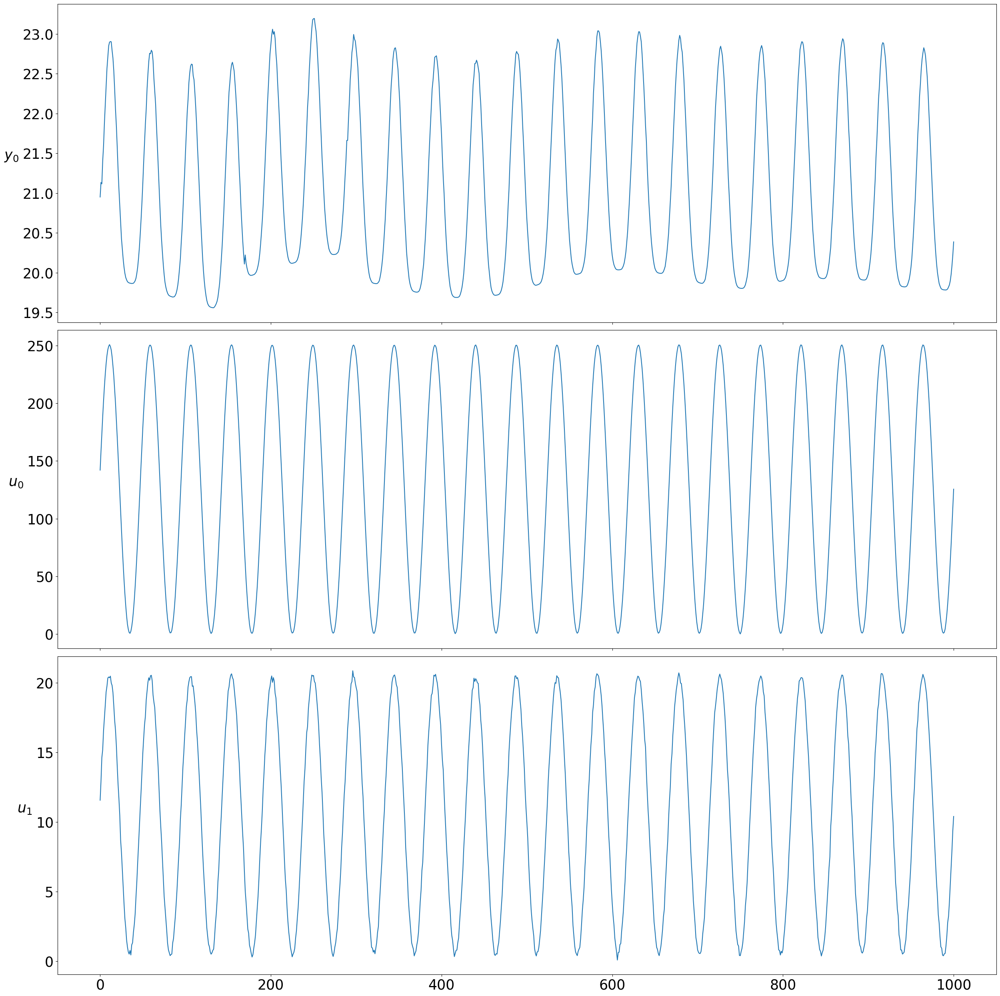

Reno_full


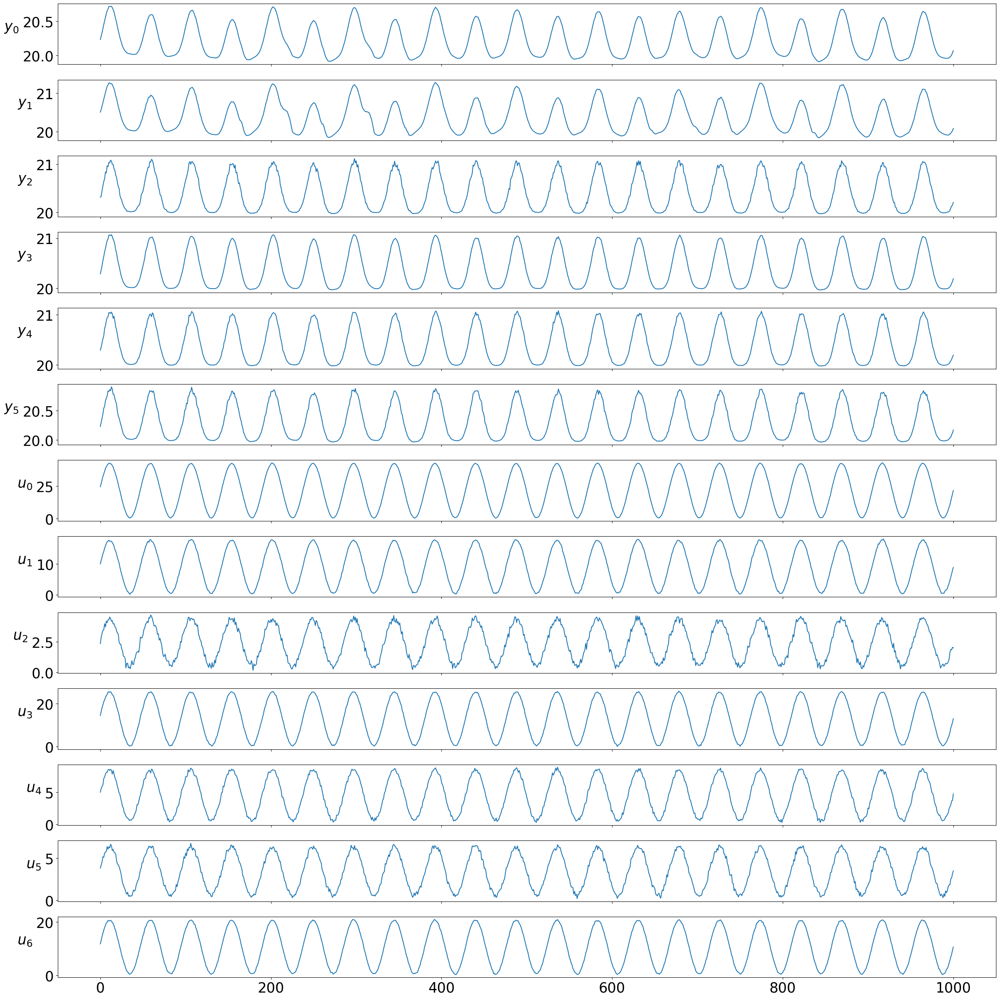

Reno_ROM40


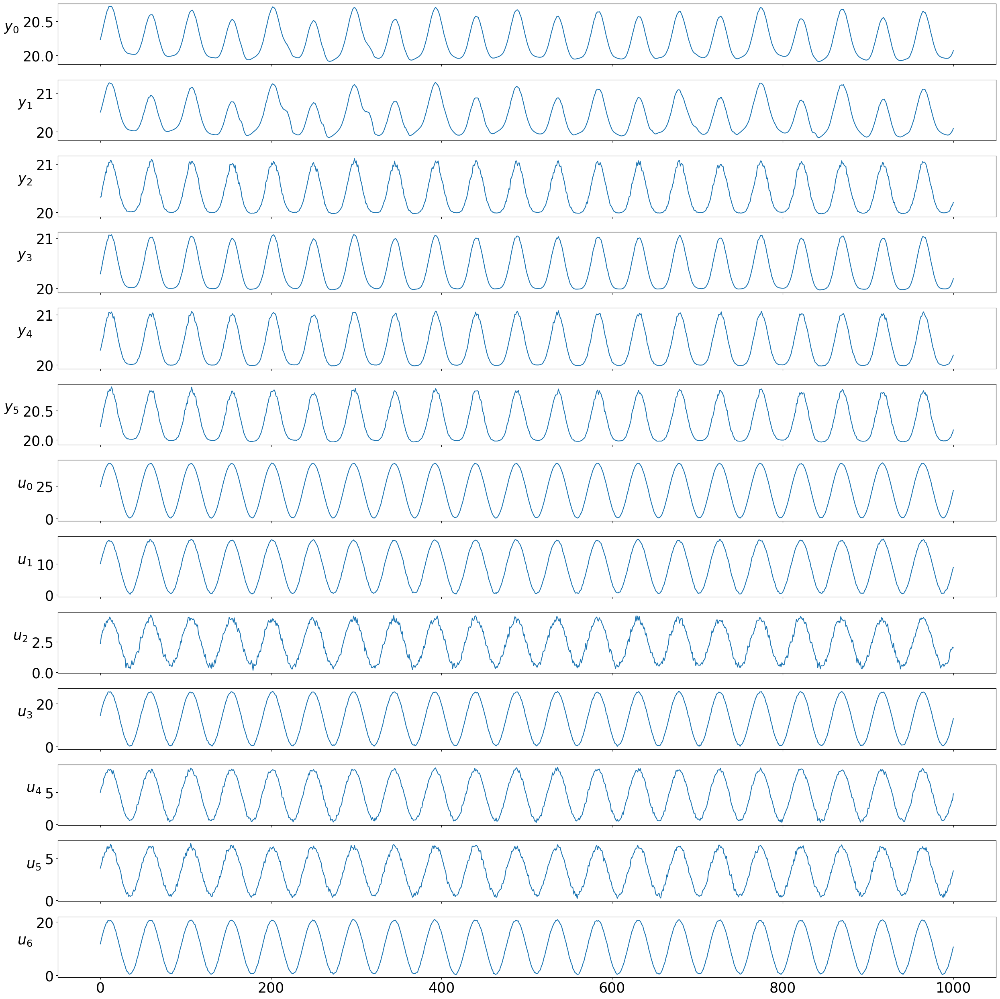

RenoLight_full


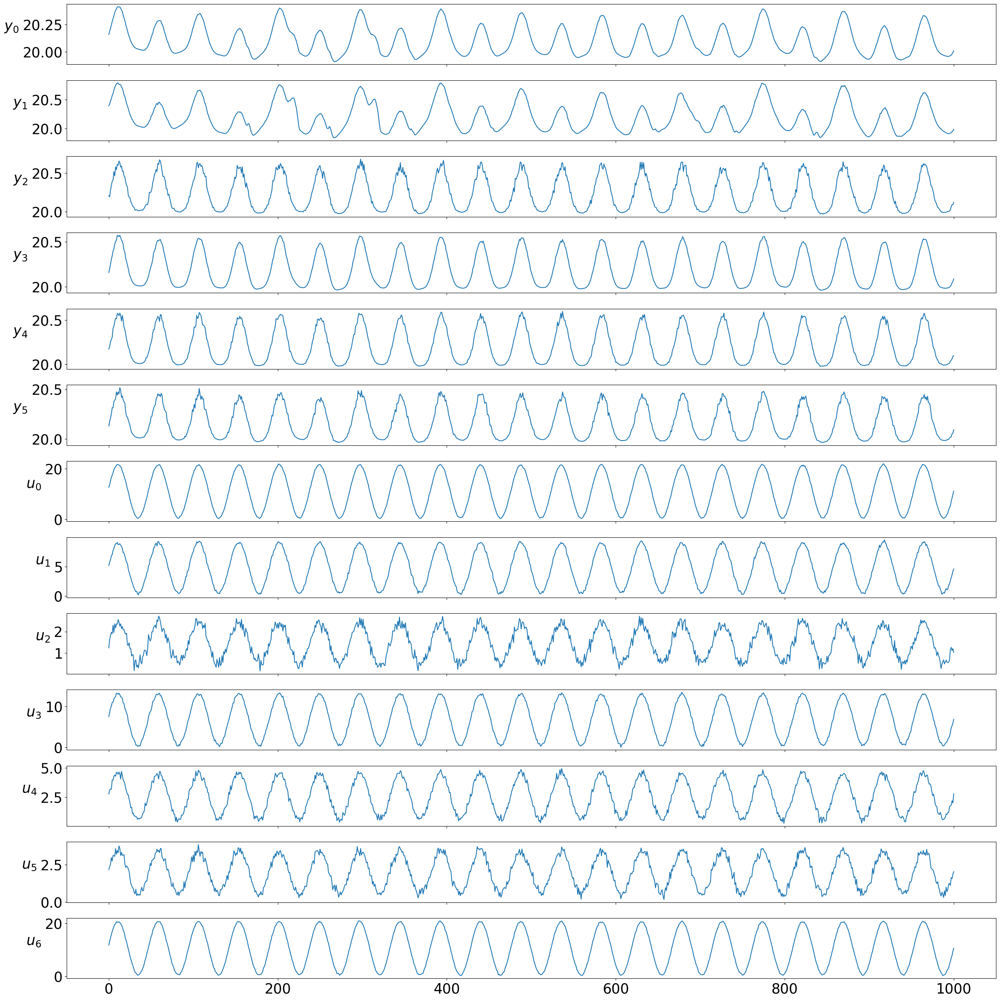

RenoLight_ROM40


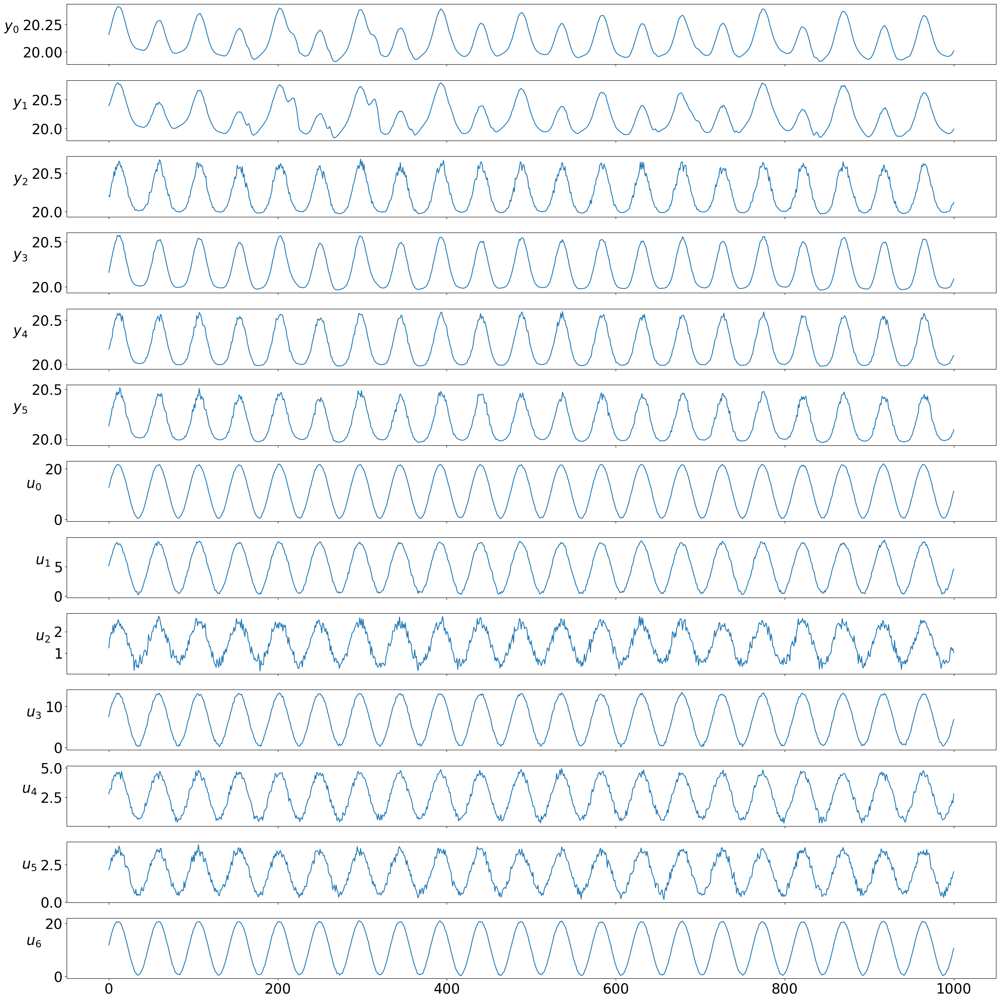

Old_full


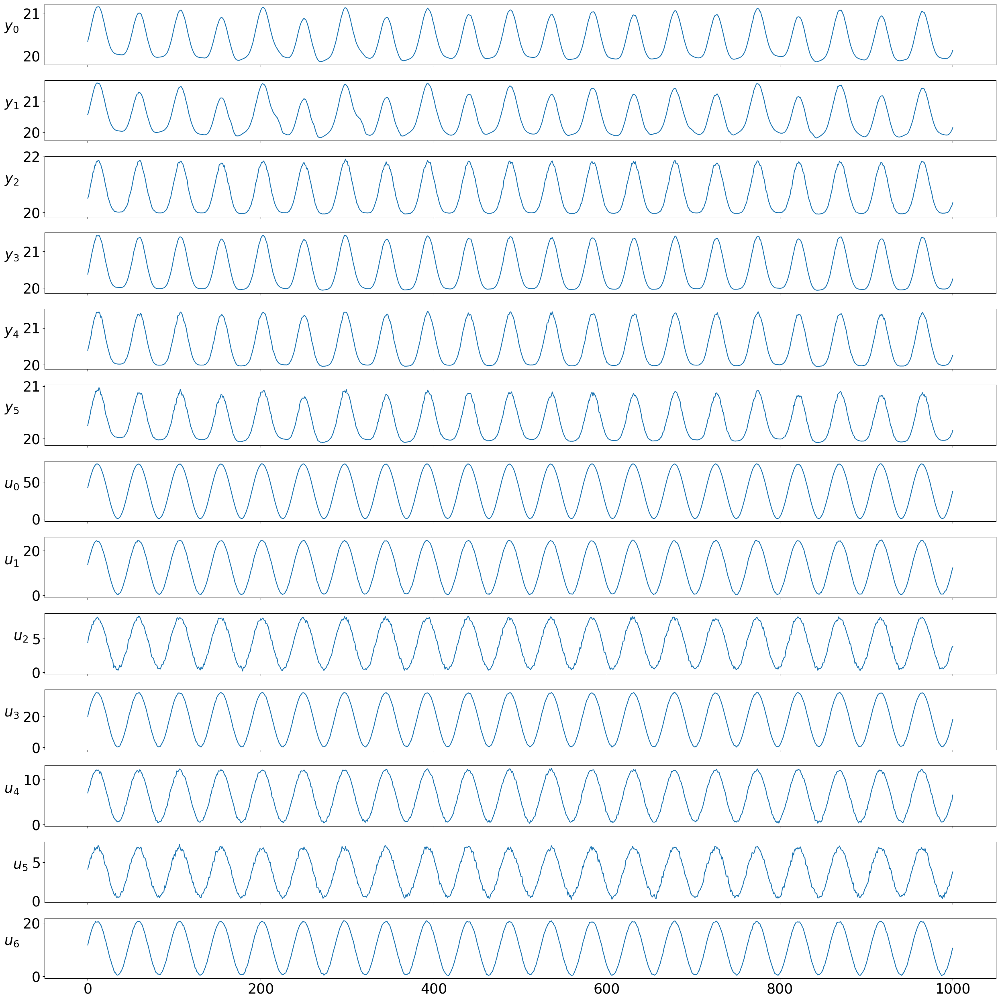

Old_ROM40


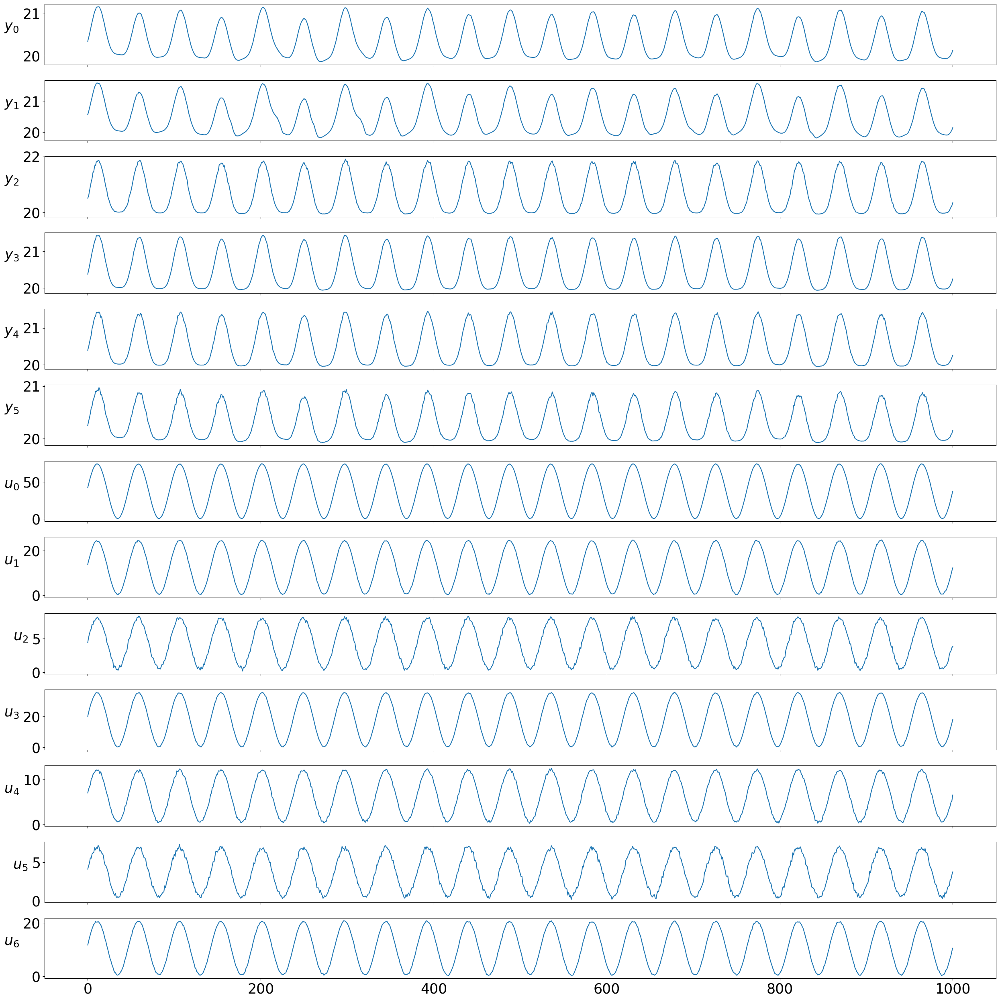

HollandschHuys_full


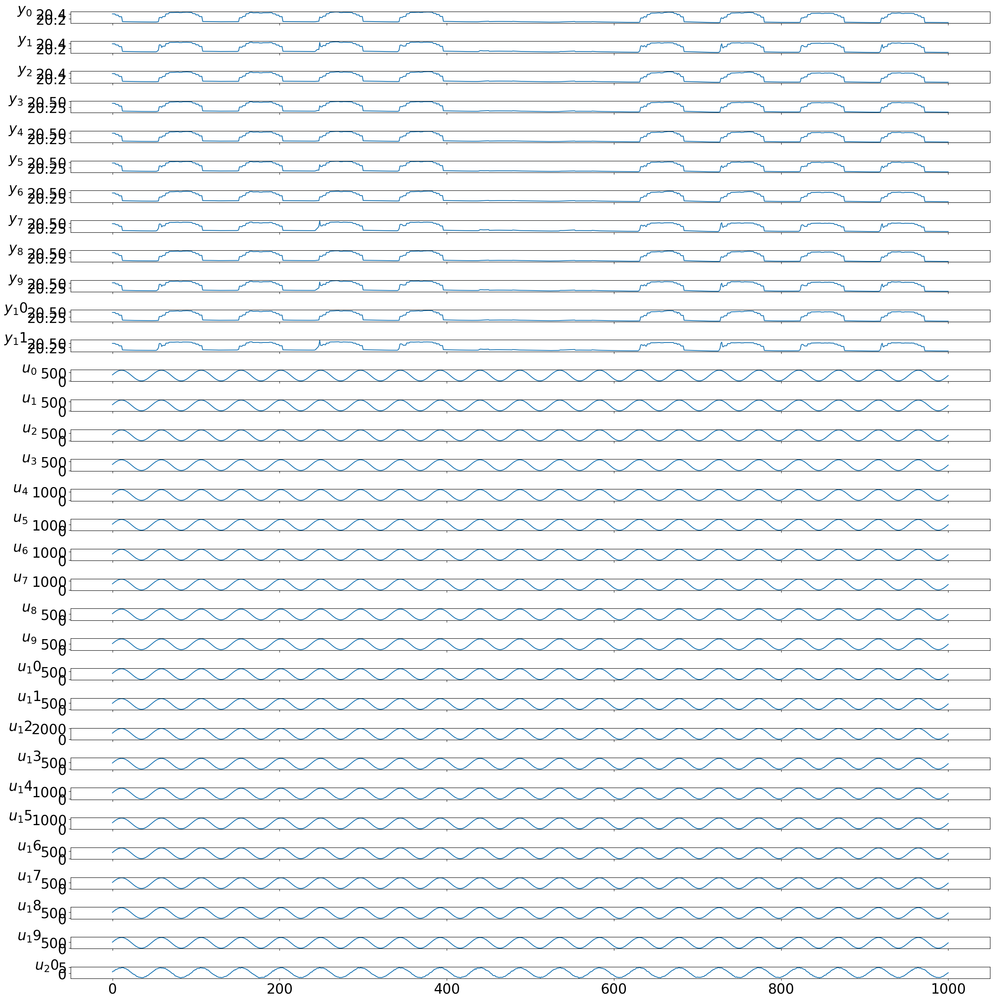

HollandschHuys_ROM100


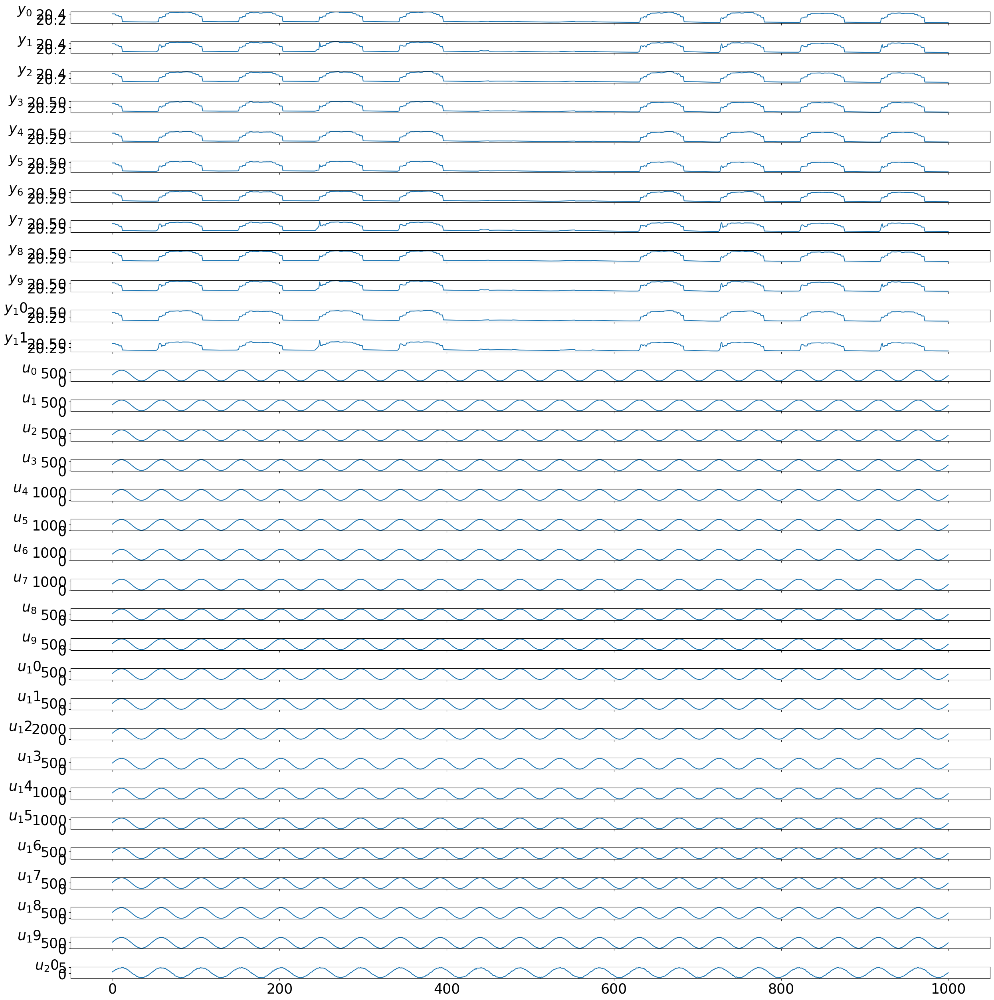

LinearSimpleSingleZone


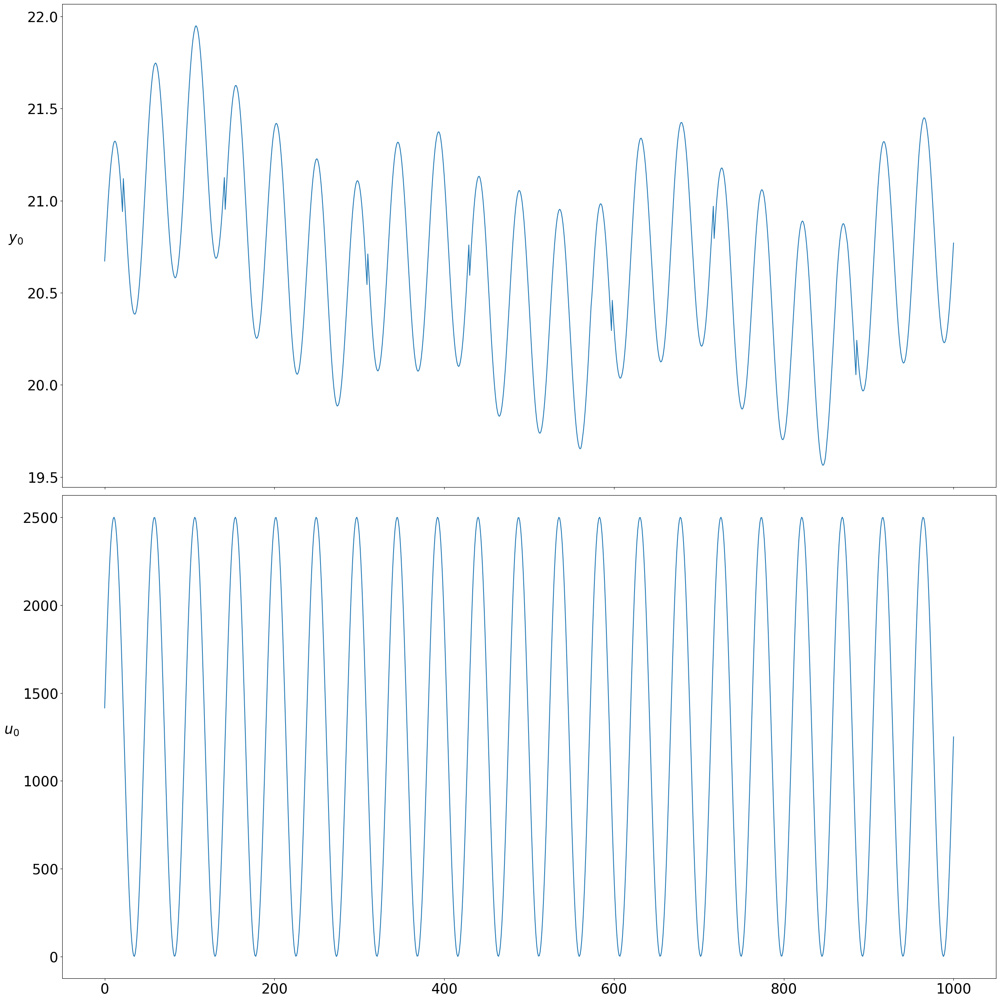

LinearReno_full


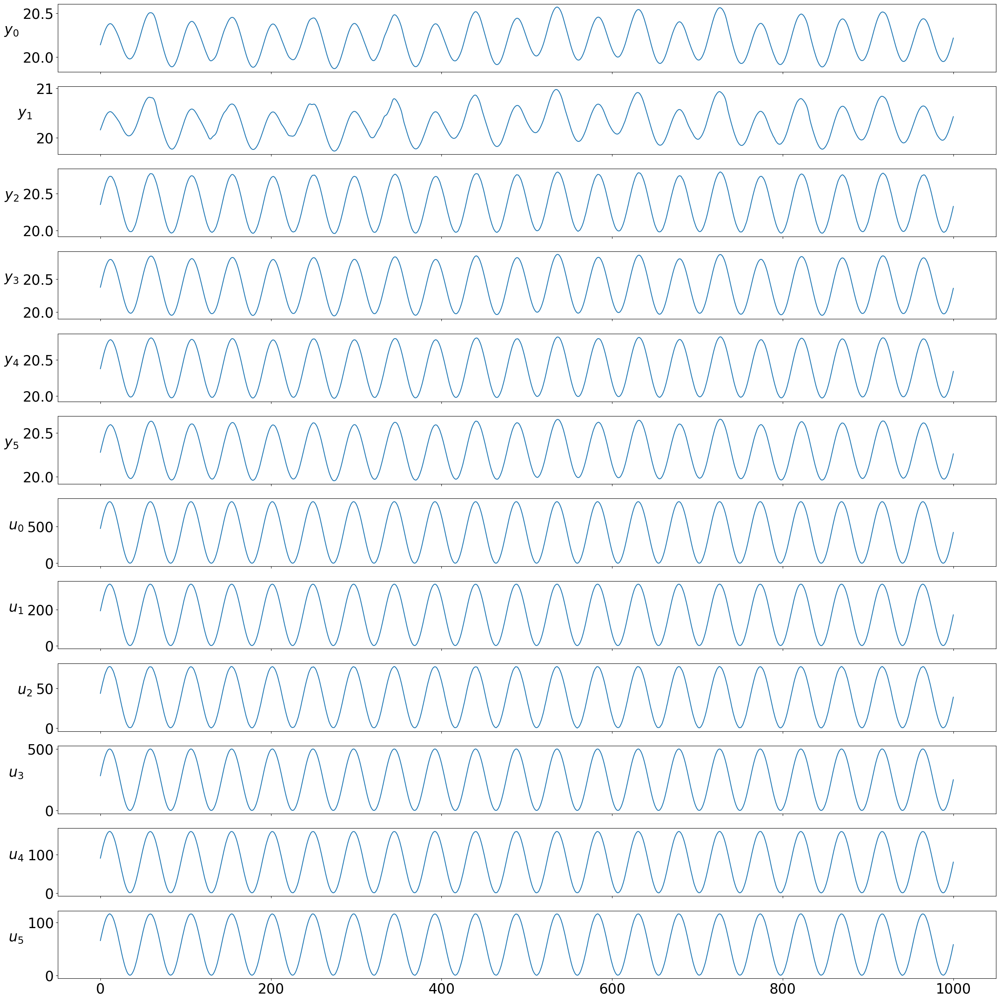

LinearReno_ROM40


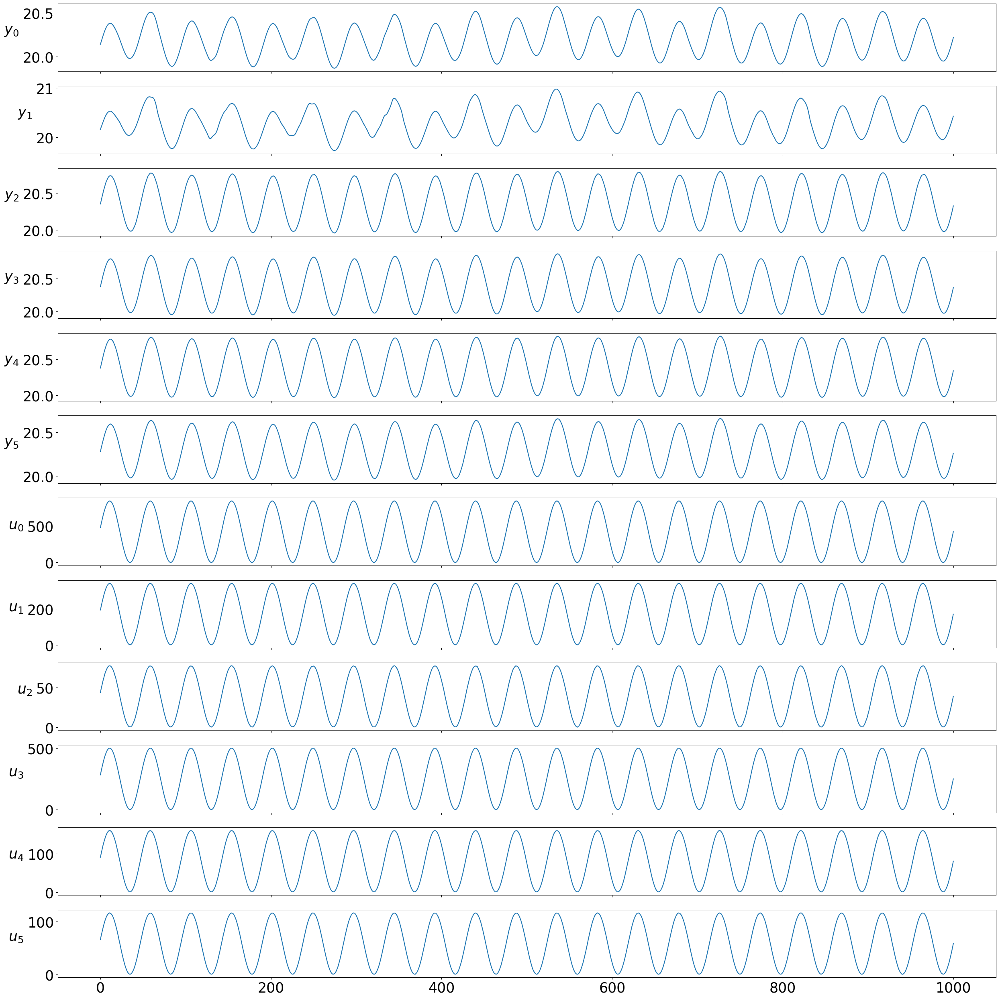

LinearRenoLight_full


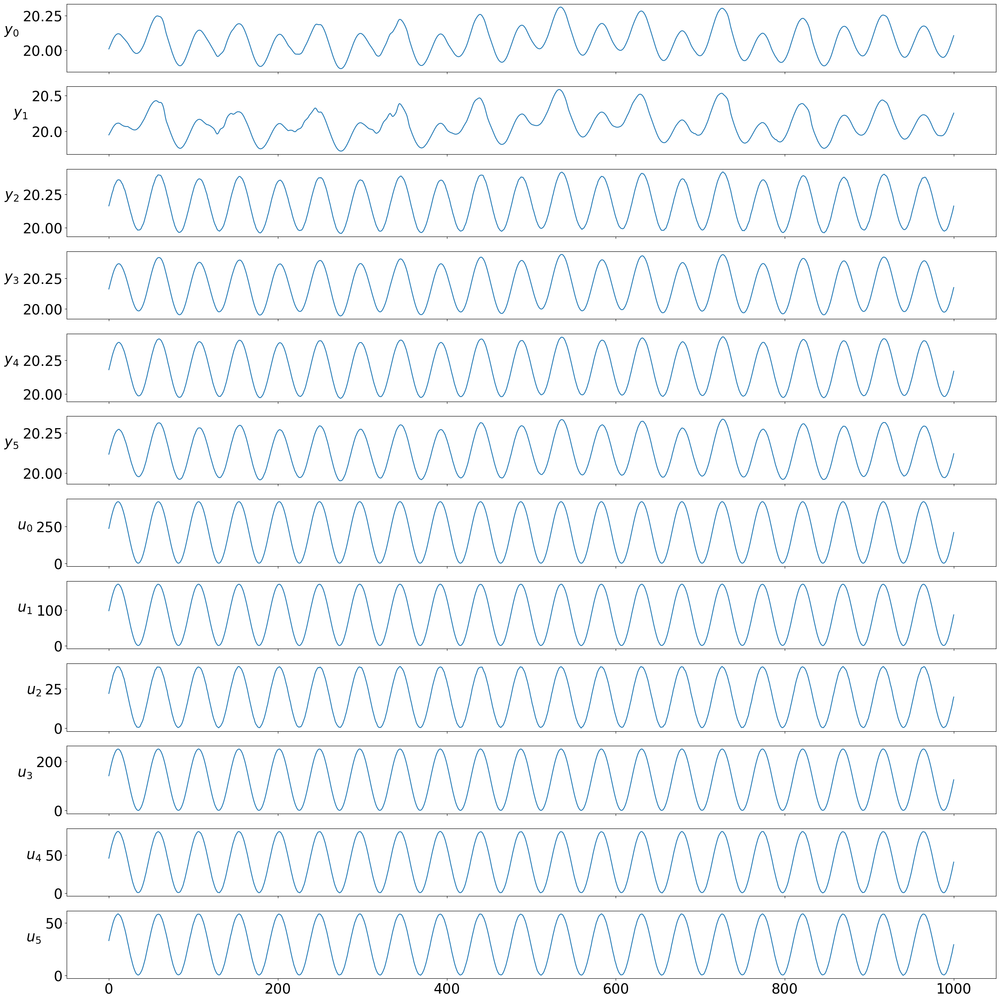

LinearRenoLight_ROM40


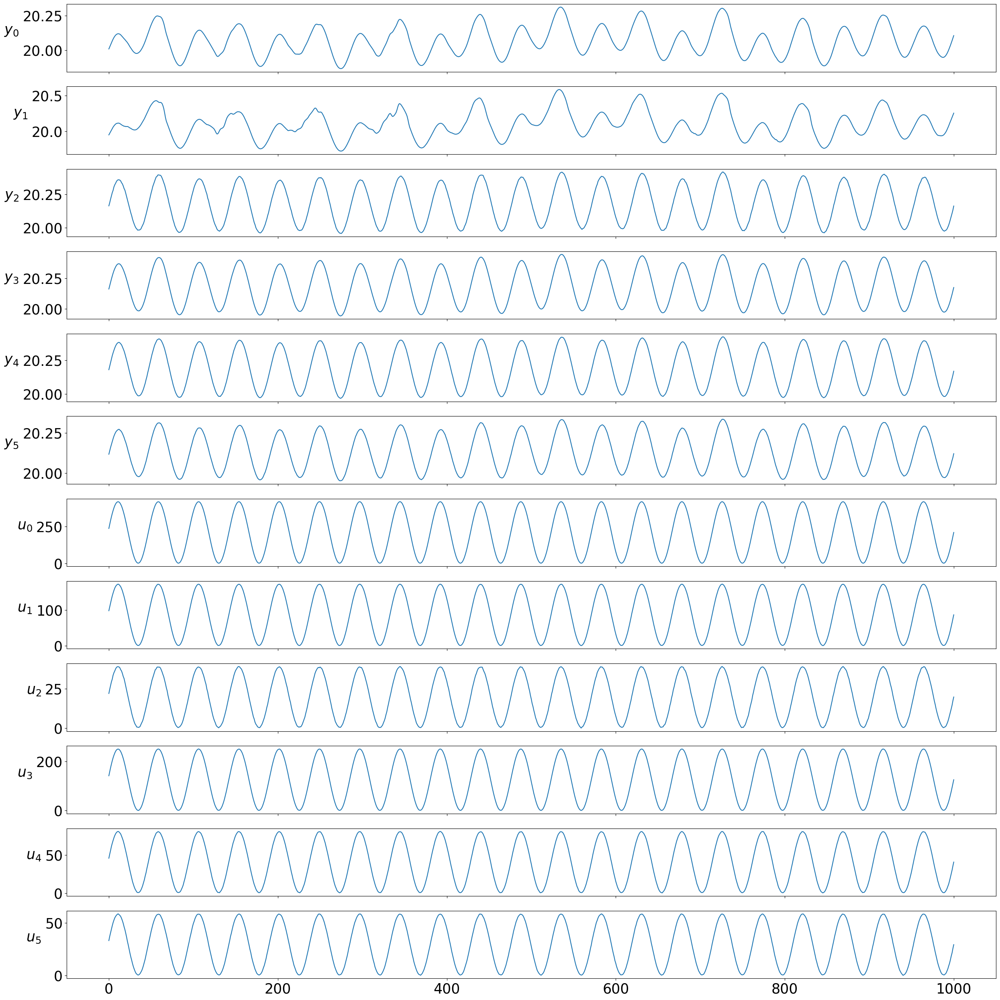

LinearOld_full


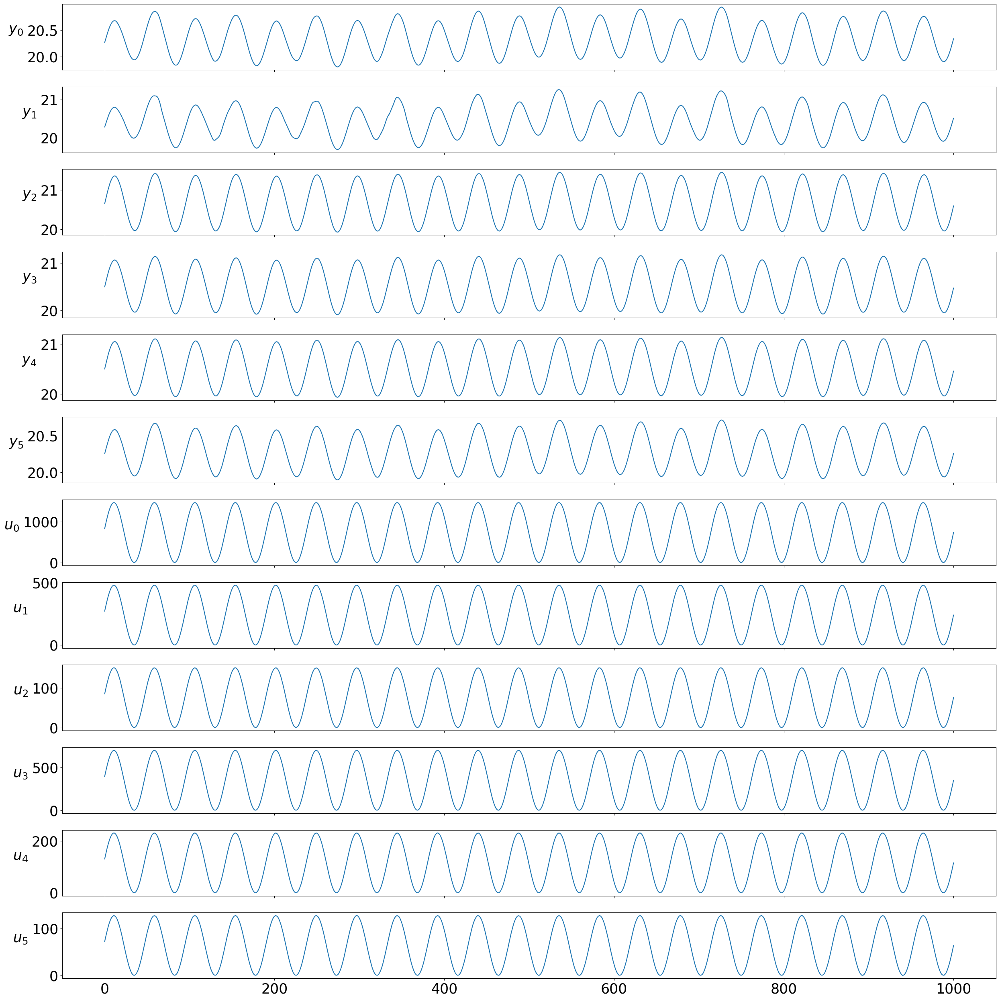

LinearOld_ROM40


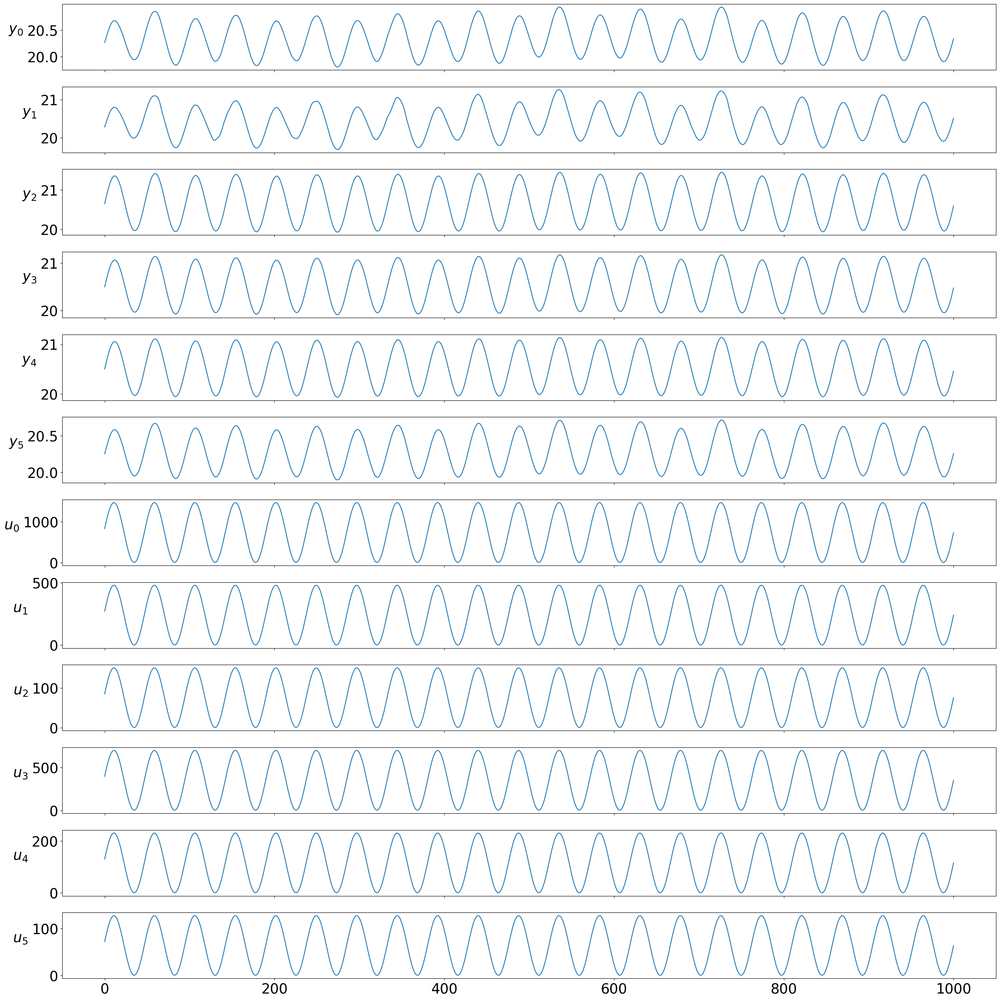

LinearHollandschHuys_full


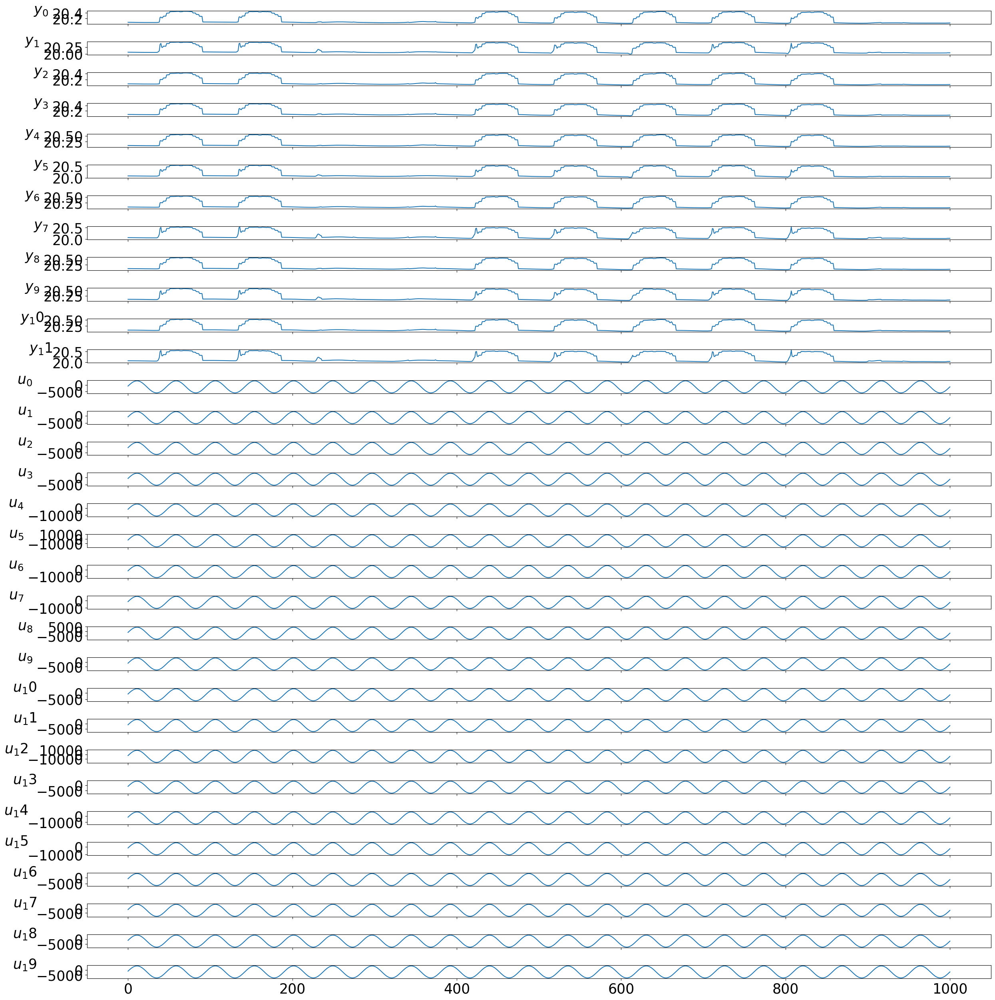

LinearHollandschHuys_ROM100


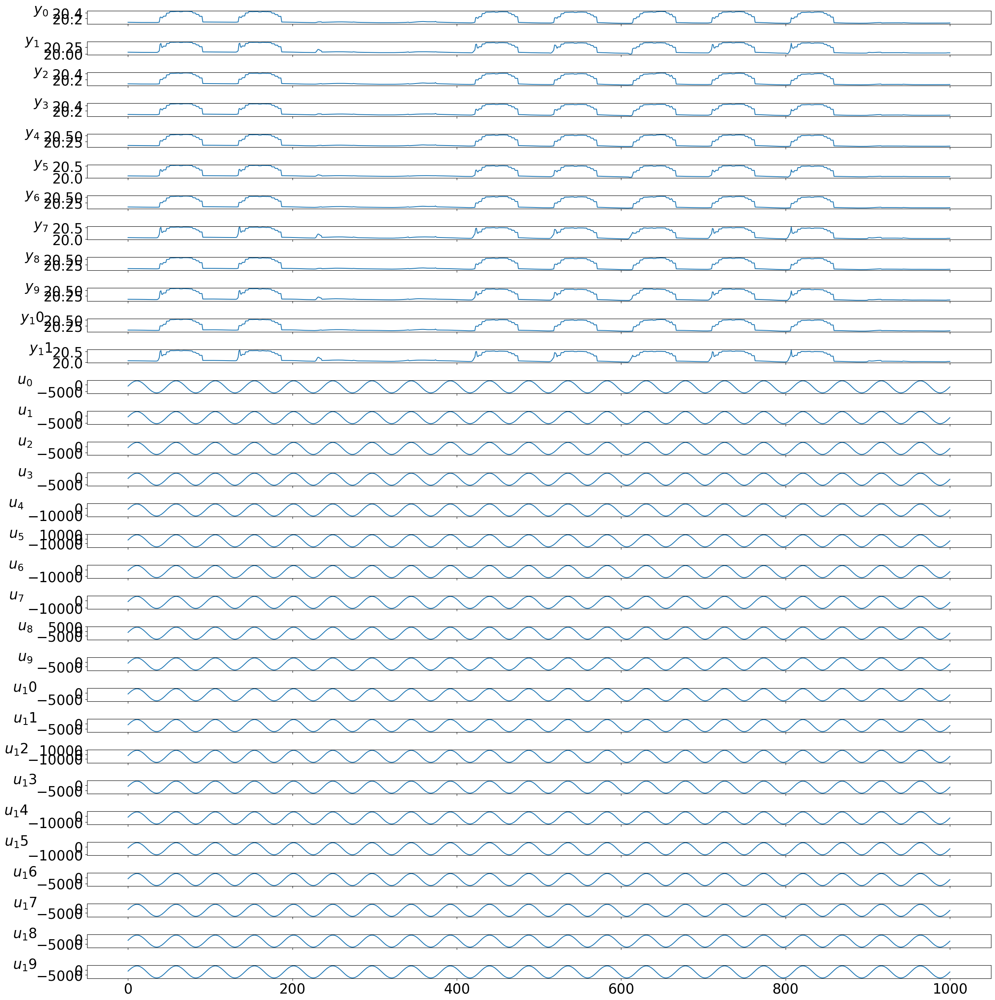

In [5]:
for n, sys in neuromancer.psl.systems.items():
    print(n)
    sys().show()
    plt.close()

In [4]:
sys = neuromancer.psl.systems['CSTR']()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'number of inputs: {sys.nu}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)

Changing inputs and states: {'x0': [0.87725294608097, 324.475443431599], 'U': array([[302.54422],
       [302.54422],
       [302.54422],
       ...,
       [299.65955],
       [297.83478],
       [297.83478]], dtype=float32)}
Constants defining simulation: {'ts': 0.1, 'Ca_ss': 0.87725294608097, 'T_ss': 324.475443431599}
Parameters of the system: {'q': 100.0, 'V': 100.0, 'rho': 1000.0, 'Cp': 0.239, 'mdelH': 50000.0, 'EoverR': 8750.0, 'k0': 72000000000.0, 'UA': 50000.0, 'u_ss': 300.0, 'Tf': 350.0, 'Caf': 1.0}
number of inputs: 1
state dimension: 2
{'U': {'max': array([302.7706], dtype=float32),
       'mean': array([299.82373], dtype=float32),
       'min': array([297.45825], dtype=float32),
       'std': array([1.5504583], dtype=float32),
       'var': array([2.4039211], dtype=float32)},
 'X': {'max': array([  0.90559566, 331.1146    ], dtype=float32),
       'mean': array([  0.8755062, 324.47723  ], dtype=float32),
       'min': array([  0.81776965, 320.68536   ], dtype=float32),
    

# Defining an ODE based dynamical system in PSL

Consider the hamiltonian system on a plane defined by the ordinary differential equations: 
\dot{\theta} = \phi, \dot{\phi} = -\frac{g}{l}\sin\theta

$$x_0^{\prime} = x_1$$
$$x_1^{\prime} = \frac{g}{l} \sin(x_0)$$

Let's define using PSL with $$g = -1, l = 1$$ to simulate an undamped pendulum with no driving force.

In [5]:
from neuromancer.psl.base import ODE_Autonomous, cast_backend
import numpy as np

class Hamiltonian(ODE_Autonomous):

    @property
    def params(self):
        variables = {'x0': [-2., 2.]} # Initial condition
        constants = {'ts': 0.1} # Time step for numerical simulation
        parameters = {'g': -1., # parameters of the hamiltonian system
                      'l': 1.}
        meta = {}
        return variables, constants, parameters, meta
        
    @cast_backend
    def equations(self, t, x):
        return [x[1], (self.g/self.l)*np.sin(x[0])]
    

Changing inputs and states: {'x0': [-2.0, 2.0]}
Constants defining simulation: {'ts': 0.1}
Parameters of the system: {'g': -1.0, 'l': 1.0}
state dimension: 2
{'X': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)},
 'Y': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)}}


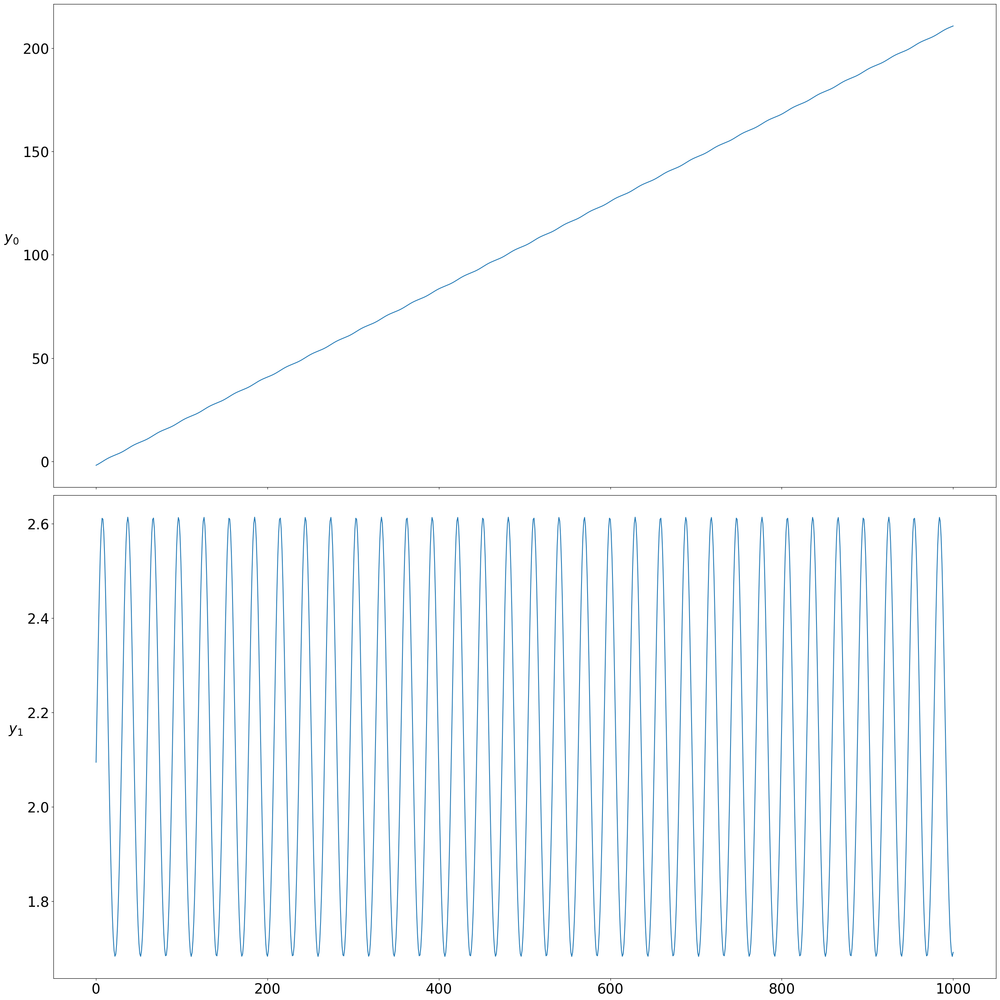

In [6]:
sys = Hamiltonian()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)
sys.show()
plt.close()

In [7]:
def plot_field(sys, xlim, ylim, scale=100, density=15j):
    X, Y = np.mgrid[xlim[0]:xlim[1]:density, ylim[0]:ylim[1]:density]
    print(X.shape, Y.shape)
    u, v = sys.equations(None, [X, Y])
    print(u.shape, v.shape)
    plt.quiver(X, Y, u, v, color='b', scale=scale)


(15, 15) (15, 15)
(15, 15) (15, 15)


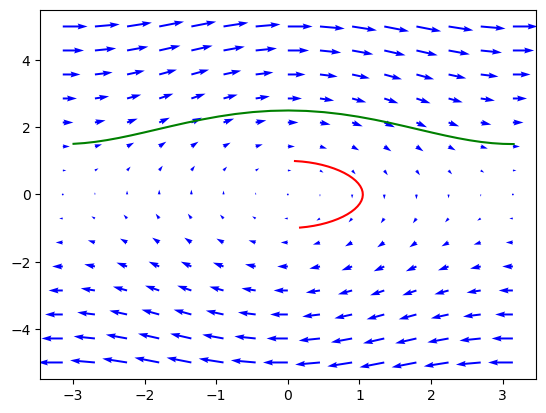

In [11]:
plot_field(Hamiltonian(), (-np.pi, np.pi), (-5, 5))
sys.ts = 0.1
data1 = sys.simulate(nsim=32, x0=np.array([0, 1]))
data2 = sys.simulate(nsim=32, x0=np.array([-np.pi, 1.5]))
plt.plot(data1['X'][:, 0], data1['X'][:, 1], c='r')
plt.plot(data2['X'][:, 0], data2['X'][:, 1], c='g')
# plt.xlim((-2*np.pi, 2*np.pi))

# Modeling a dynamical system from data with NODEs

Let's say we have measurements of this system from a sample of initial conditions simulated for 400 time-steps. How many uniformly sampled initial conditions does it take to learn a decent model of this system? 

(15, 15) (15, 15)
(15, 15) (15, 15)


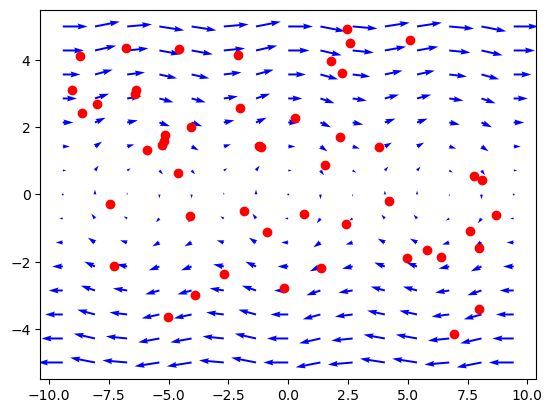

In [8]:
from neuromancer.system import EulerIntegrator, Node, System
import torch
# Sample 50 initial conditions covering the range of system behavior. 
x0s = np.random.uniform(low=np.array([-3*np.pi, -5.]), high=np.array([3*np.pi, 5]), size=(50, 2))
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


(15, 15) (15, 15)
(15, 15) (15, 15)


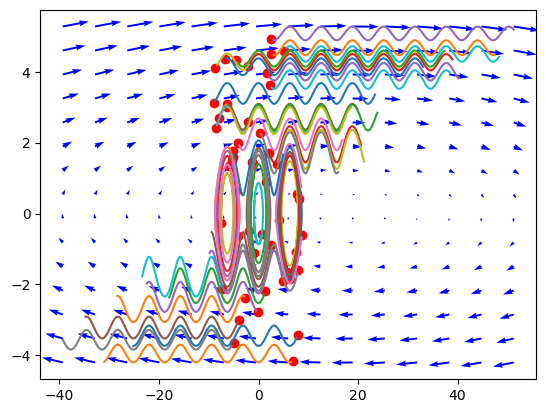

In [11]:
samples = [sys.simulate(nsim=96, x0=x0) for x0 in x0s]
X = np.concatenate([s['X'] for s in samples])
maxx, minx = X[:, 0].max(), X[:, 0].min()
maxy, miny = X[:, 1].max(), X[:, 1].min()

plot_field(sys, (minx, maxx), (miny, maxy))
for s in samples:
    plt.plot(s['X'][:, 0], s['X'][:, 1])
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


In [12]:
# Change the default system stats to statistics from our training set
pprint.pprint(sys.stats)
sys.set_stats(sim={'X': X})
pprint.pprint(sys.stats)

# Create a pytorch dataloader for use in training the system model
samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
samples = sys.normalize(samples)
samples['X'].shape, type(samples['X'])


{'X': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)},
 'Y': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)}}
{'X': {'max': array([51.254845,  5.280031], dtype=float32),
       'mean': array([2.943715  , 0.74276525], dtype=float32),
       'min': array([-39.32077 ,  -4.204583], dtype=float32),
       'std': array([13.363239,  2.473253], dtype=float32),
       'var': array([178.57617 ,   6.116981], dtype=float32)}}


(torch.Size([50, 96, 2]), torch.Tensor)

In [13]:
from neuromancer.dataset import DictDataset

# Make a function to generate data
def get_data(sys, xmin, xmax, nstep, nsamples, name='train'):
    
    # Sample initial conditions
    x0s = np.random.uniform(low=xmin, high=xmax, size=(nsamples, sys.nx))
    
    # Create nsamples simulations with sampled initial conditions
    samples = [sys.simulate(nsim=nstep, x0=x0) for x0 in x0s]
    
    # Calculate min and max for plotting axis bounds    
    X = np.concatenate([s['X'] for s in samples])
    maxx, minx = X[:, 0].max(), X[:, 0].min()
    maxy, miny = X[:, 1].max(), X[:, 1].min()

    # Plot vector field, initial conditions and samples
    plot_field(sys, (minx, maxx), (miny, maxy))
    for s in samples:
        plt.plot(s['X'][:, 0], s['X'][:, 1])
    plt.scatter(x0s[:, 0], x0s[:, 1], c='r')
    
    if name == 'train':
        # Change the default system stats to statistics from our training set
        pprint.pprint(sys.stats)
        sys.set_stats(sim={'X': X})
        pprint.pprint(sys.stats)

    # Create a pytorch dataloader
    samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
    
    samples = sys.normalize(samples)
    samples['xn'] = samples['X'][:, 0:1, :]
    data = DictDataset(samples, name=name)
    loader = torch.utils.data.DataLoader(data, num_workers=1, batch_size=50, collate_fn=data.collate_fn,
                                         shuffle=True)
    return loader

(15, 15) (15, 15)
(15, 15) (15, 15)
{'X': {'max': array([51.254845,  5.280031], dtype=float32),
       'mean': array([2.943715  , 0.74276525], dtype=float32),
       'min': array([-39.32077 ,  -4.204583], dtype=float32),
       'std': array([13.363239,  2.473253], dtype=float32),
       'var': array([178.57617 ,   6.116981], dtype=float32)}}
{'X': {'max': array([50.548347,  5.035321], dtype=float32),
       'mean': array([-0.92983574, -0.34262088], dtype=float32),
       'min': array([-50.263355 ,  -5.0516562], dtype=float32),
       'std': array([15.809757,  2.709114], dtype=float32),
       'var': array([249.94841  ,   7.3392987], dtype=float32)}}


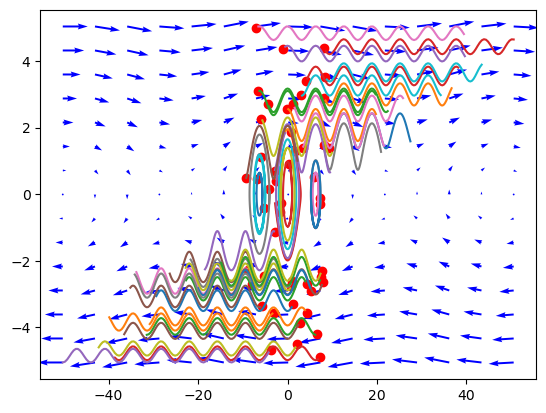

In [14]:
train_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='train')

(15, 15) (15, 15)
(15, 15) (15, 15)


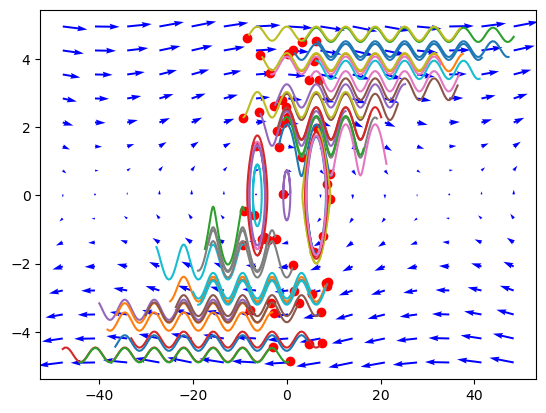

In [15]:
dev_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='dev')

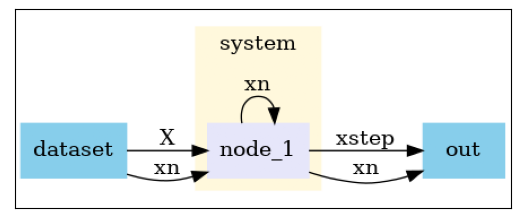

In [20]:
from neuromancer.system import Node, System, EulerIntegrator
from neuromancer.blocks import MLP
from neuromancer.integrators import Euler
from neuromancer.activations import SoftExponential

# linargs = {'sigma_min': .95, 'sigma_max': 1.05}
class MultipleShootingEulerIntegrator(torch.nn.Module):
    """
    Simple black-box NODE
    """
    def __init__(self, nx, hsize, nlayers, ts):
        super().__init__()
        self.dx = MLP(nx, nx, hsizes=[hsize for h in range(nlayers)], nonlin=SoftExponential)
        self.integrator = Euler(self.dx, h=torch.tensor(ts))

    def forward(self, x1, xn):
        """

        :param xn: (Tensor, shape=(batchsize, nx)) State
        :param u: (Tensor, shape=(batchsize, nu)) Control action
        :return: (Tensor, shape=(batchsize, nx)) xn+1
        """
        return self.integrator(x1), self.integrator(xn)

nx = 2
hsize = 64
nlayers = 3
integrator = MultipleShootingEulerIntegrator(nx, hsize, nlayers, sys.ts)
node = Node(integrator, ['X', 'xn'], ['xstep', 'xn'])
system = System([node])
system.show()

In [25]:
from neuromancer.trainer import Trainer
from neuromancer.loggers import BasicLogger
from neuromancer.constraint import variable
from neuromancer.loss import PenaltyLoss
from neuromancer.problem import Problem

logger = BasicLogger(stdout=['train_objective_loss', 'dev_loss1', 'dev_loss2'], verbosity=1)
opt = torch.optim.AdamW(integrator.parameters(), 0.01)
xpred = variable('xn')[:, :-1, :]
xtrue = variable('X')
x1pred = variable('xstep')

loss1 = 0.1*(xpred == xtrue) ^ 2
loss1.update_name('loss1')
loss2 = (x1pred[:, :-1, :] == xtrue[:, 1:, :])^2
loss2.update_name('loss2')

obj = PenaltyLoss([loss1, loss2], [])
problem = Problem([system], obj)

trainer = Trainer(problem, train_data, dev_data, dev_data, opt, logger,
                  epochs=200,
                  patience=1000,
                  train_metric='train_objective_loss',
                  dev_metric='dev_loss',
                  test_metric='test_loss',
                  eval_metric='dev_loss')


None
Number of parameters: 8645


In [26]:
best_model = trainer.train()

epoch: 0	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  10.75151
epoch: 1	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  13.12999
epoch: 2	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  15.46839
epoch: 3	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  17.95536
epoch: 4	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  20.03559
epoch: 5	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  21.51659
epoch: 6	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  22.87428
epoch: 7	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  24.51610
epoch: 8	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  25.93876
epoch: 9	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  27.29194
epoch: 10	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  28.72989
epoch: 11	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  30.07222
ep

epoch: 98	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  137.19780
epoch: 99	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  138.35737
epoch: 100	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  139.38505
epoch: 101	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  140.69602
epoch: 102	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  141.87473
epoch: 103	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  143.01396
epoch: 104	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  144.33071
epoch: 105	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  145.51095
epoch: 106	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  146.65071
epoch: 107	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  147.82972
epoch: 108	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  149.20634
epoch: 109	train_objective_loss: nan	dev_loss1: nan	dev_

epoch: 194	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  264.16536
epoch: 195	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  265.67883
epoch: 196	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  266.88992
epoch: 197	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  268.20122
epoch: 198	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  269.65573
epoch: 199	train_objective_loss: nan	dev_loss1: nan	dev_loss2: nan	eltime:  271.02057


In [19]:
trainer.model.load_state_dict(best_model)
problem.loss = PenaltyLoss([loss1], [])
opt.param_groups[0]['lr'] = 0.1
best_model = trainer.train()


NameError: name 'best_model' is not defined

In [ ]:
class rhs_wrapper:
    
    def __init__(self, dx, sys):
        self.dx = dx
        self.sys = sys
        
    def equations(self, t, X):
        X = torch.tensor(np.stack(X, axis=-1), dtype=torch.float32).reshape(-1, 2)
        print(X.shape)
        X = self.sys.normalize(X, key='X')
        output = self.dx(X)
        output = self.sys.denormalize(output, key='X')
        output = output.reshape(15, 15, 2).detach().numpy()
        return output[:, :, 0], output[:, :, 1]

problem.load_state_dict(best_model)
        
rhs = integrator.dx
func = rhs_wrapper(rhs, sys)
plot_field(func, (-3*np.pi, 3*np.pi), (-5, 5))

In [ ]:
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))

# Non-autonomous system ID for control

In [ ]:
sys = pkg.systems['LinearSimpleSingleZone']()
sys.show()

In [ ]:
# Non-autonomous NODE
class EulerIntegrator(torch.nn.Module):
    """
    Simple black-box NODE
    """
    def __init__(self, ny, nu, nd, hsize, nlayers, ts):
        super().__init__()
        self.dy = MLP(ny + nu + nd, ny, bias=True, linear_map=nn.Linear, nonlin=SoftExponential,
                      hsizes=[hsize for h in range(nlayers)])
        interp_u = lambda tq, t, u: u
        self.integrator = Euler(self.dy, h=0.001, interp_u=interp_u)
        self.bias = nn.Parameter(torch.randn(ny), requires_grad=True)

    def forward(self, yn, ystep, u, d):
        """

        :param xn: (Tensor, shape=(batchsize, nx)) State
        :param u: (Tensor, shape=(batchsize, nu)) Control action
        :return: (Tensor, shape=(batchsize, nx)) xn+1
        """
        return self.integrator(yn, u=torch.cat([u, d], dim=-1)), self.integrator(ystep, u=torch.cat([u, d], dim=-1)) + self.bias

# Closed loop system for Control

Notes: 
+ Lotka Volterra might be an easier system.
+ Overfit on a single initial condition and look at learned vector field
    + subtract learned vector field from ground truth and make a contour map
    
    